In [ ]:
# Generates new Pokemon using GAN
# JM
# ANLY 590 Final Project
# add useful library
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import os
from PIL import Image
import imageio
from google.colab import drive

In [ ]:
drive.mount("/content/drive", force_remount=True)

Mounted at /content/drive


In [ ]:
%cd /content/drive/My Drive/Pokemon/Pokemon/pokemon-images-and-types

/content/drive/My Drive/Pokemon/Pokemon/pokemon-images-and-types


In [ ]:

 
# change directory
dir = "images/"

In [ ]:
# read in the data
data = []
for i in os.listdir(dir):
        
    img = imageio.imread(dir + i)
    img = Image.fromarray(img)
    img.load()
    
        
    if(len(img.split()) == 4):
        
       
        im = Image.new('RGB', img.size, (255, 255, 255))
        im.paste(img, mask=img.split()[3])
           
        
    else:
        im = img
    pixels = tf.keras.preprocessing.image.img_to_array(im)
    pixels = pixels.astype("float32")
    pixels /= 255.
    data.append(pixels)
    


In [ ]:
dataset = np.stack(data)
dataset.shape

(809, 120, 120, 3)

In [ ]:
# define discriminator
def discriminator(inp_shape = (120,120,3)):
    model = tf.keras.models.Sequential([
        tf.keras.layers.Conv2D(128, (3,3), strides = (2,2), padding="same", input_shape = inp_shape),
        tf.keras.layers.LeakyReLU(0.2),
        
        tf.keras.layers.Conv2D(128, (3,3), padding="same",  strides = (2,2)),
        tf.keras.layers.LeakyReLU(0.2),
        
        tf.keras.layers.Conv2D(64, (3,3), padding="same",  strides = (2,2)),
        tf.keras.layers.LeakyReLU(0.2),
        
        tf.keras.layers.Conv2D(64, (3,3), padding = "same", strides = (2,2)),
        tf.keras.layers.Dropout(0.2),

        tf.keras.layers.Conv2D(32, (3,3), padding="same",  strides = (2,2)),
        tf.keras.layers.LeakyReLU(0.2),

        tf.keras.layers.Conv2D(32, (3,3), padding = "same", strides = (2,2)),
        tf.keras.layers.Dropout(0.2),

        tf.keras.layers.Flatten(),
        
        tf.keras.layers.Dense(1, activation = "sigmoid")
    ])
    model.compile(optimizer = tf.keras.optimizers.Adam(0.0002, beta_1=0.5), loss = "binary_crossentropy", metrics = ['acc'])
    return model


In [ ]:
d_model = discriminator()
d_model.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_8 (Conv2D)            (None, 60, 60, 128)       3584      
_________________________________________________________________
leaky_re_lu_14 (LeakyReLU)   (None, 60, 60, 128)       0         
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 30, 30, 128)       147584    
_________________________________________________________________
leaky_re_lu_15 (LeakyReLU)   (None, 30, 30, 128)       0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 15, 15, 64)        73792     
_________________________________________________________________
leaky_re_lu_16 (LeakyReLU)   (None, 15, 15, 64)        0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 8, 8, 64)         

In [ ]:
# generate fake Pokemon to train discriminator
def generate_fake_samples(n_samples):
    rand_samp = np.random.randn(120 * 120 * 3 * n_samples)
    rand_samp = -1 + rand_samp * 2
    X = rand_samp.reshape(n_samples, 120, 120, 3)
    y = np.zeros(shape = (n_samples,1))
    return X,y

In [ ]:
# train discriminator
def train_discriminator(model, dataset, num_iterations = 20, n_batch = 128):
    half_batch = int(n_batch/2)
    for i in range(num_iterations):
        X_real, y_real = generate_real_samples(dataset, half_batch)
       
        _, real_acc = model.train_on_batch(X_real, y_real)
        
        X_fake, y_fake = generate_fake_samples(half_batch)
      
        _, fake_acc = model.train_on_batch(X_fake, y_fake)
        print("Fake acc, Real acc")
        print(fake_acc)
        print(real_acc)

In [ ]:
# generate real Pokemon to train discriminator
def generate_real_samples(dataset, n_size = 128):
    ind = np.random.randint(0, dataset.shape[0], n_size)
    data = dataset[ind]
    y = np.ones((n_size, 1))
    return data, y

In [ ]:
# define generator
def generator(latent_dim = 100):
    model = tf.keras.models.Sequential([
        tf.keras.layers.Dense(128 * 15 * 15, input_dim = latent_dim),
        tf.keras.layers.LeakyReLU(0.2),
        tf.keras.layers.Reshape((15,15,128)),
        
        
        tf.keras.layers.Conv2DTranspose(128, (3,3), strides = (2,2), padding = "same"),
        tf.keras.layers.LeakyReLU(0.2),
        
        
        tf.keras.layers.Conv2DTranspose(128, (3,3), strides = (2,2), padding = "same"),
        tf.keras.layers.LeakyReLU(0.2),
        
        
        tf.keras.layers.Conv2DTranspose(64, (3,3), strides = (2,2), padding = "same"),
        tf.keras.layers.LeakyReLU(0.2),

       
        
        tf.keras.layers.Conv2D(3, (3,3), padding = "same", activation = "sigmoid")
        
    ])
    return model


In [ ]:
g_model = generator()
g_model.summary()

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_6 (Dense)              (None, 28800)             2908800   
_________________________________________________________________
leaky_re_lu_27 (LeakyReLU)   (None, 28800)             0         
_________________________________________________________________
reshape_4 (Reshape)          (None, 15, 15, 128)       0         
_________________________________________________________________
conv2d_transpose_15 (Conv2DT (None, 30, 30, 128)       147584    
_________________________________________________________________
leaky_re_lu_28 (LeakyReLU)   (None, 30, 30, 128)       0         
_________________________________________________________________
conv2d_transpose_16 (Conv2DT (None, 60, 60, 128)       147584    
_________________________________________________________________
leaky_re_lu_29 (LeakyReLU)   (None, 60, 60, 128)      

In [ ]:
# generate real and fake pokemon
X_real, y_real = generate_real_samples(dataset,800)
X_fake, y_fake = generate_fake_samples(800)
X,y = np.vstack((X_real, X_fake)), np.vstack((y_real, y_fake))

In [ ]:
# generate latent space
# we use normal distribution as latent space
def generate_latent_space(n_size = 128, latent_dim = 100):
    points = np.random.randn(n_size * latent_dim)
    points = points.reshape((n_size, latent_dim))
    return points

In [ ]:
# generate new fake pokemons using generator
def generate_fake_examples(g_model, n_size = 128, latent_dim = 100):
    latent_space = generate_latent_space(n_size, latent_dim)
    preds = g_model.predict(latent_space)
    y = np.zeros((n_size , 1))
    return preds, y

In [ ]:
# GAN model
def gan(g_model, d_model):
    d_model.trainable = False
    model = tf.keras.models.Sequential([
        g_model,
        d_model
    ])
    model.compile(optimizer = tf.keras.optimizers.Adam(0.0002, beta_1=0.5), loss = "binary_crossentropy")
    return model

In [ ]:
gan_model = gan(g_model, d_model)

In [ ]:
# plot new pokemon
def plot_samples(data):
    plt.figure(figsize = (15,15))
    for i in range(7*7):
        plt.subplot(7,7,i+1)
        plt.axis("off")
        plt.imshow(data[i])
    plt.show()

In [ ]:
def summarize_performance(g_model, dataset, n_size = 128):
    X_real, y_real = generate_real_samples(dataset)
    _,accr = d_model.evaluate(X_real, y_real)
    
    X_fake, y_fake = generate_fake_examples(g_model)
    _, accf = d_model.evaluate(X_fake, y_fake)
    
    print("Real samples Acc: {}".format(accr*100))
    print("Fake samples Acc: {}".format(accf*100))
    
    plot_samples(X_fake)


In [ ]:
def plot_history(d1_hist, d2_hist, g_hist, a1_hist, a2_hist):
	
	plt.subplot(2, 1, 1)
	plt.plot(d1_hist, label='d-real')
	plt.plot(d2_hist, label='d-fake')
	plt.plot(g_hist, label='gen')
	plt.legend()
	

	plt.subplot(2, 1, 2)
	plt.plot(a1_hist, label='acc-real')
	plt.plot(a2_hist, label='acc-fake')
	plt.legend()
	

	plt.close()

In [ ]:
def train(g_model, d_model, gan_model, dataset,epochs = 2000, latent_dim = 100, batch_size = 128):
    half_batch = int(batch_size/2)
    batch_per_epoch = int(len(dataset)/batch_size)
    d1_hist, d2_hist, g_hist, a1_hist, a2_hist = list(), list(), list(), list(), list()
    for i in range(epochs):
        for j in range(batch_per_epoch):
            X_real, y_real = generate_real_samples(dataset, half_batch)
            d_loss1, d_acc1 = d_model.train_on_batch(X_real, y_real)
            
            X_fake, y_fake = generate_fake_examples(g_model, half_batch)
            d_loss2, d_acc2 = d_model.train_on_batch(X_fake, y_fake)
            
            X_gan = generate_latent_space()
            y_gan = np.ones((batch_size, 1))
            
            g_loss = gan_model.train_on_batch(X_gan, y_gan)
            
            d1_hist.append(d_loss1)
            d2_hist.append(d_loss2)
            g_hist.append(g_loss)
            a1_hist.append(d_acc1)
            a2_hist.append(d_acc2)
            
            if((j+1) % 5 == 0):
                print("dis loss", "i")
                print(d_loss1, d_loss2, i)
        
        if((i+1) % 50 == 0):
            summarize_performance(g_model, dataset)
    plot_history(d1_hist, d2_hist, g_hist, a1_hist, a2_hist)
            

dis loss i
0.3730142116546631 0.4115842878818512 0
dis loss i
0.34078723192214966 0.3184819221496582 1
dis loss i
0.1796988993883133 0.22636725008487701 2
dis loss i
0.2089744210243225 0.10854512453079224 3
dis loss i
0.24654488265514374 0.1664859801530838 4
dis loss i
0.5653434991836548 0.6986804604530334 5
dis loss i
0.39269280433654785 0.5013775825500488 6
dis loss i
0.13363896310329437 0.1839718520641327 7
dis loss i
0.36685439944267273 0.48641639947891235 8
dis loss i
0.15602266788482666 0.3891753554344177 9
dis loss i
0.12206931412220001 0.25507548451423645 10
dis loss i
0.21921144425868988 0.2330879420042038 11
dis loss i
0.3888683021068573 0.36573025584220886 12
dis loss i
0.18024635314941406 0.14884580671787262 13
dis loss i
0.14254911243915558 0.3882843255996704 14
dis loss i
0.18926003575325012 0.09258794784545898 15
dis loss i
0.6016653776168823 0.6035304665565491 16
dis loss i
0.37674951553344727 0.27283936738967896 17
dis loss i
0.11107362806797028 0.28490859270095825 18


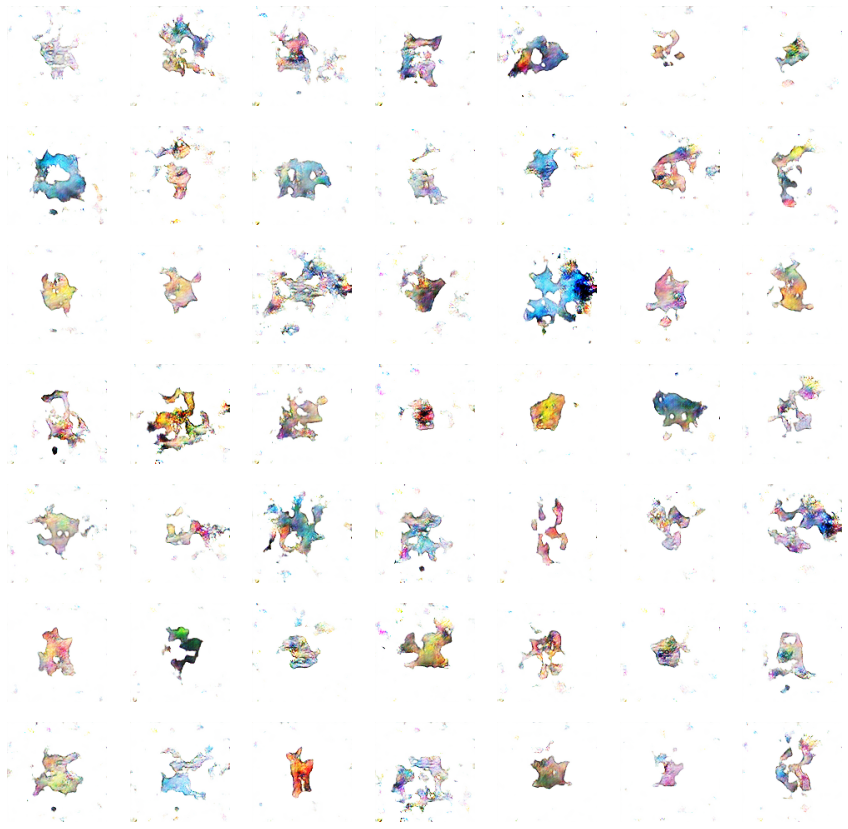

dis loss i
0.18139545619487762 0.24788963794708252 50
dis loss i
0.11991201341152191 0.21365073323249817 51
dis loss i
0.12224793434143066 0.13367076218128204 52
dis loss i
0.2672407031059265 0.2789238691329956 53
dis loss i
0.18781450390815735 0.14639830589294434 54
dis loss i
0.15868204832077026 0.15748846530914307 55
dis loss i
0.3647839426994324 0.29071447253227234 56
dis loss i
0.14174938201904297 0.17007127404212952 57
dis loss i
0.2626565098762512 0.17141880095005035 58
dis loss i
0.17295873165130615 0.260001003742218 59
dis loss i
0.36246538162231445 0.3075200617313385 60
dis loss i
0.09970070421695709 0.14400766789913177 61
dis loss i
0.8845990896224976 0.7878683805465698 62
dis loss i
0.38247883319854736 0.241611048579216 63
dis loss i
0.18158620595932007 0.2410515397787094 64
dis loss i
0.1234513446688652 0.2566863000392914 65
dis loss i
0.2835337519645691 0.3971179723739624 66
dis loss i
0.30039384961128235 0.35004276037216187 67
dis loss i
0.20690329372882843 0.20460377633

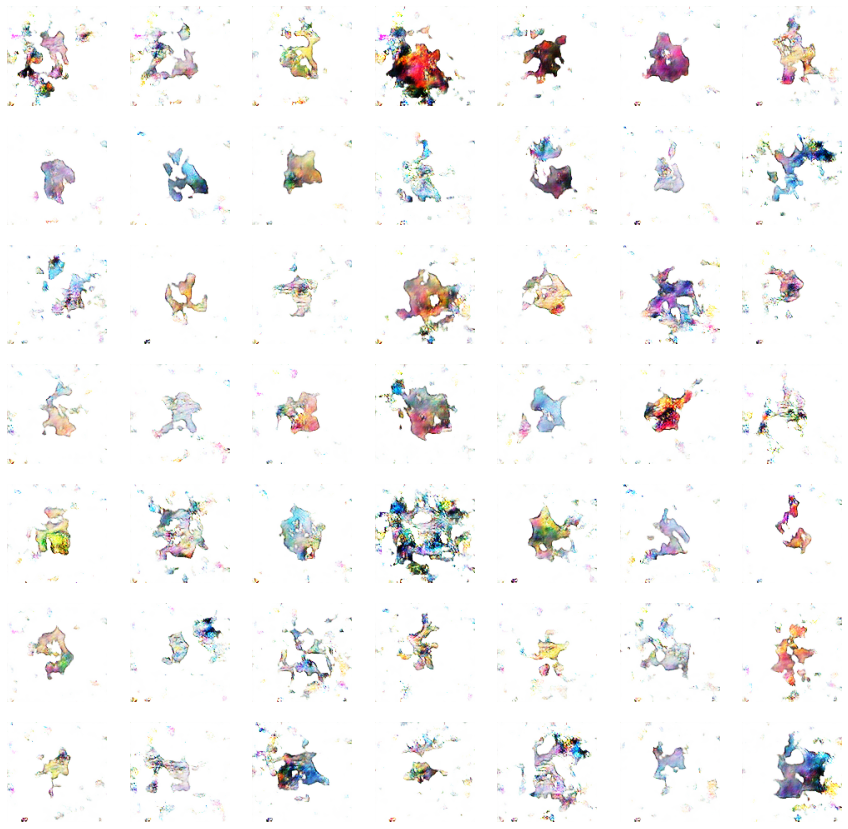

dis loss i
0.2093421369791031 0.23588471114635468 100
dis loss i
0.13698068261146545 0.22388362884521484 101
dis loss i
0.30769720673561096 0.36058130860328674 102
dis loss i
0.2744330167770386 0.2606836259365082 103
dis loss i
0.0994286835193634 0.41577276587486267 104
dis loss i
0.09967731684446335 0.3063569962978363 105
dis loss i
0.08695913851261139 0.07304258644580841 106
dis loss i
0.2934638559818268 0.217713862657547 107
dis loss i
0.19230401515960693 0.11929024755954742 108
dis loss i
0.26701343059539795 0.37787723541259766 109
dis loss i
0.12699052691459656 0.09349272400140762 110
dis loss i
0.12748540937900543 0.2257457673549652 111
dis loss i
0.07084585726261139 0.10198897123336792 112
dis loss i
0.1480378955602646 0.2945617437362671 113
dis loss i
0.09835506975650787 0.25000572204589844 114
dis loss i
0.132165789604187 0.10500523447990417 115
dis loss i
0.22179311513900757 0.2572093605995178 116
dis loss i
0.6145153045654297 0.44965845346450806 117
dis loss i
0.448678910732

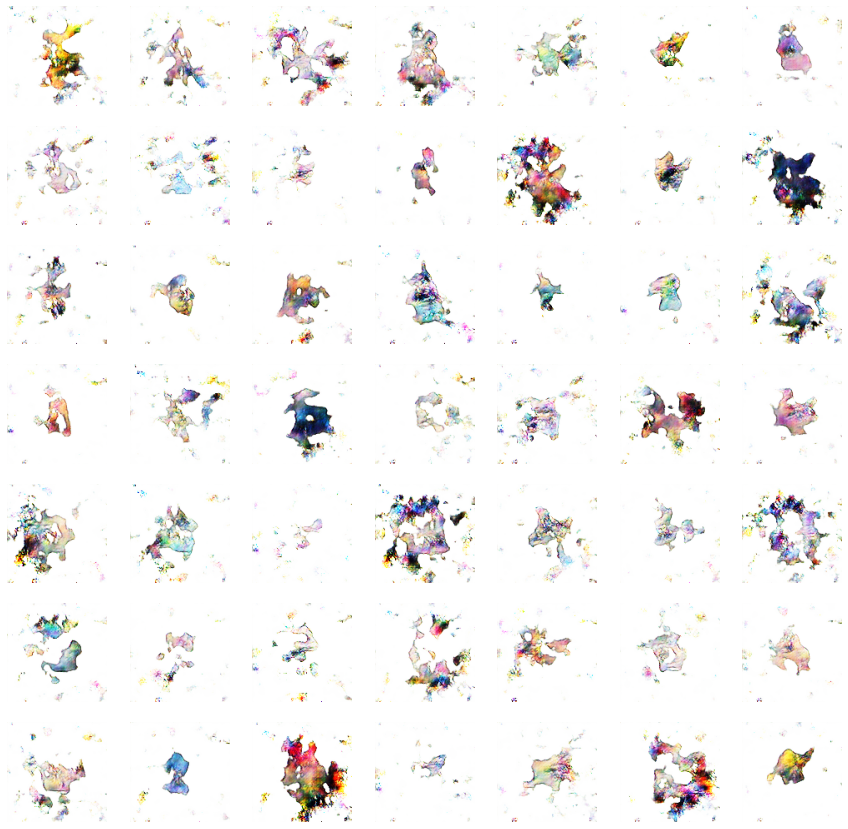

dis loss i
0.280361533164978 0.4122091829776764 150
dis loss i
0.14895564317703247 0.18010210990905762 151
dis loss i
0.5199074149131775 0.4238652288913727 152
dis loss i
0.21373561024665833 0.21148549020290375 153
dis loss i
0.11428573727607727 0.2927560806274414 154
dis loss i
0.183857724070549 0.07839880883693695 155
dis loss i
0.1859467327594757 0.167526975274086 156
dis loss i
0.09716925770044327 0.10843029618263245 157
dis loss i
0.16920378804206848 0.10849215090274811 158
dis loss i
0.1563505232334137 0.12252990901470184 159
dis loss i
0.10126784443855286 0.2171822488307953 160
dis loss i
0.1447659581899643 0.33633145689964294 161
dis loss i
0.24165719747543335 0.24876581132411957 162
dis loss i
0.17419297993183136 0.16191743314266205 163
dis loss i
0.11559739708900452 0.18435591459274292 164
dis loss i
0.11295470595359802 0.0733625739812851 165
dis loss i
0.11570161581039429 0.19897261261940002 166
dis loss i
0.08324553817510605 0.1459631621837616 167
dis loss i
0.2053632140159

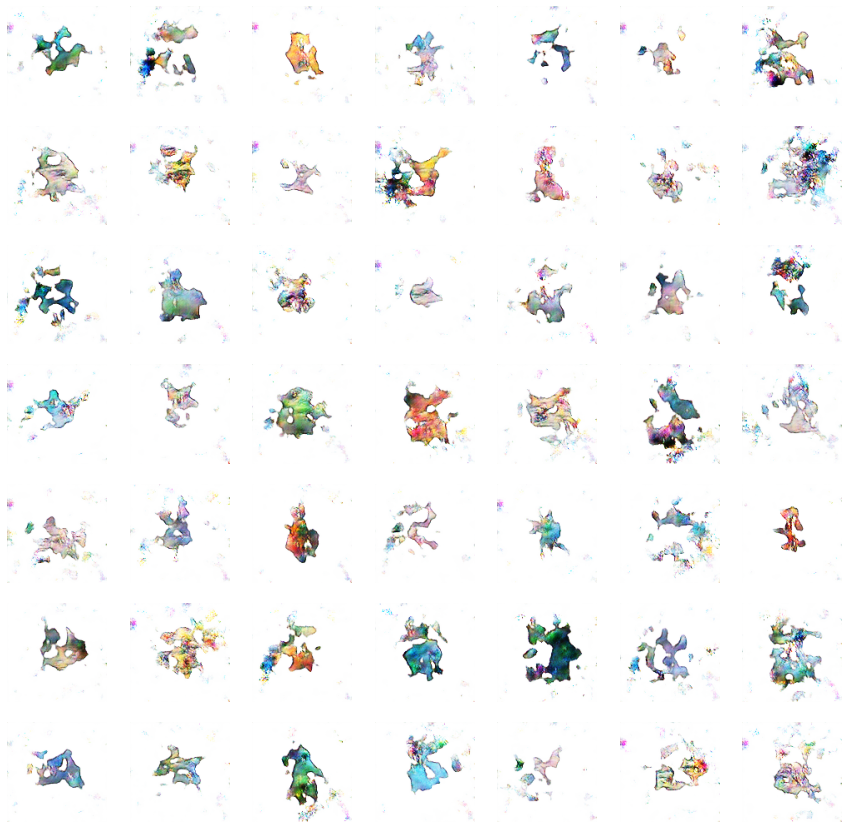

dis loss i
0.2315032184123993 0.1734207272529602 200
dis loss i
0.19327466189861298 0.15752947330474854 201
dis loss i
0.1187601312994957 0.11521109193563461 202
dis loss i
0.20296482741832733 0.1814577430486679 203
dis loss i
0.31764599680900574 0.3976669907569885 204
dis loss i
0.17635340988636017 0.2859969139099121 205
dis loss i
0.07802355289459229 0.10905945301055908 206
dis loss i
0.3496536612510681 0.2165530025959015 207
dis loss i
0.36046648025512695 0.5855636596679688 208
dis loss i
0.8462100028991699 1.1791503429412842 209
dis loss i
0.5426088571548462 0.3877454698085785 210
dis loss i
0.33328187465667725 0.4804927706718445 211
dis loss i
0.2895190715789795 0.24652491509914398 212
dis loss i
0.3796812891960144 0.24112829566001892 213
dis loss i
0.10920974612236023 0.09104900062084198 214
dis loss i
0.14983008801937103 0.38764625787734985 215
dis loss i
0.3076532483100891 0.2767186164855957 216
dis loss i
0.16593986749649048 0.13113194704055786 217
dis loss i
0.083553120493888

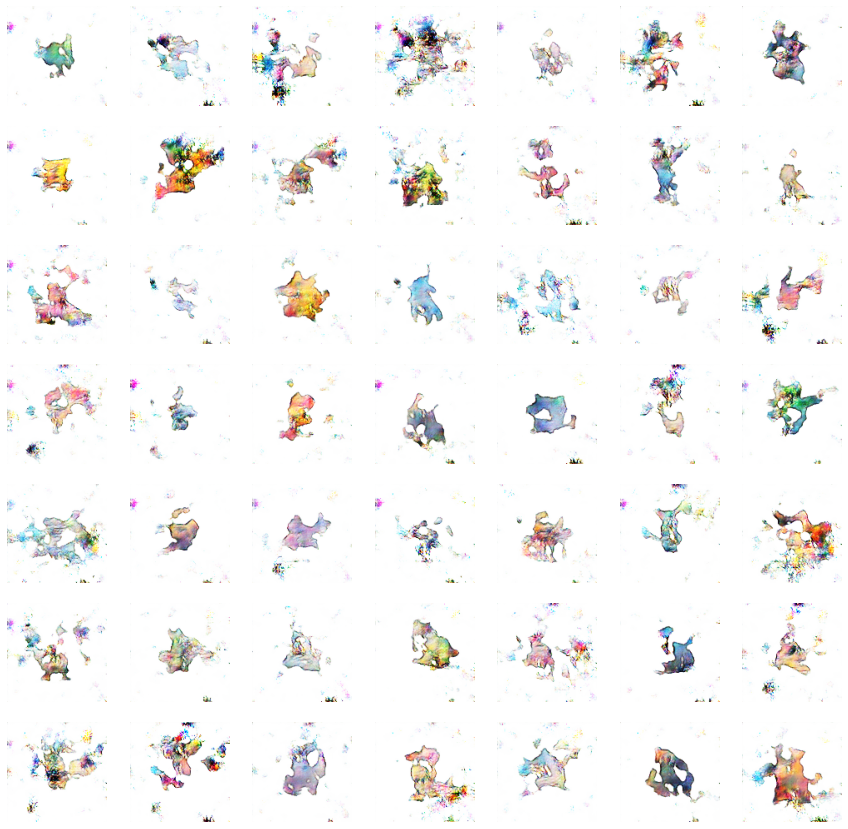

dis loss i
0.1889631152153015 0.19093115627765656 250
dis loss i
0.3995997905731201 0.48515045642852783 251
dis loss i
0.10909797251224518 0.0772802010178566 252
dis loss i
0.08150554448366165 0.05314690247178078 253
dis loss i
0.16464859247207642 0.18978893756866455 254
dis loss i
0.10052600502967834 0.12103411555290222 255
dis loss i
0.060730211436748505 0.1826593279838562 256
dis loss i
0.07781653106212616 0.05391792953014374 257
dis loss i
0.257845938205719 0.32304126024246216 258
dis loss i
0.13708195090293884 0.27556195855140686 259
dis loss i
0.08903082460165024 0.17064668238162994 260
dis loss i
0.11322040110826492 0.037842463701963425 261
dis loss i
0.1871245801448822 0.28167724609375 262
dis loss i
0.13530701398849487 0.19034507870674133 263
dis loss i
0.09640847891569138 0.09714332967996597 264
dis loss i
0.17697419226169586 0.23004281520843506 265
dis loss i
0.23750236630439758 0.20128992199897766 266
dis loss i
0.06556297093629837 0.05558080971240997 267
dis loss i
0.31686

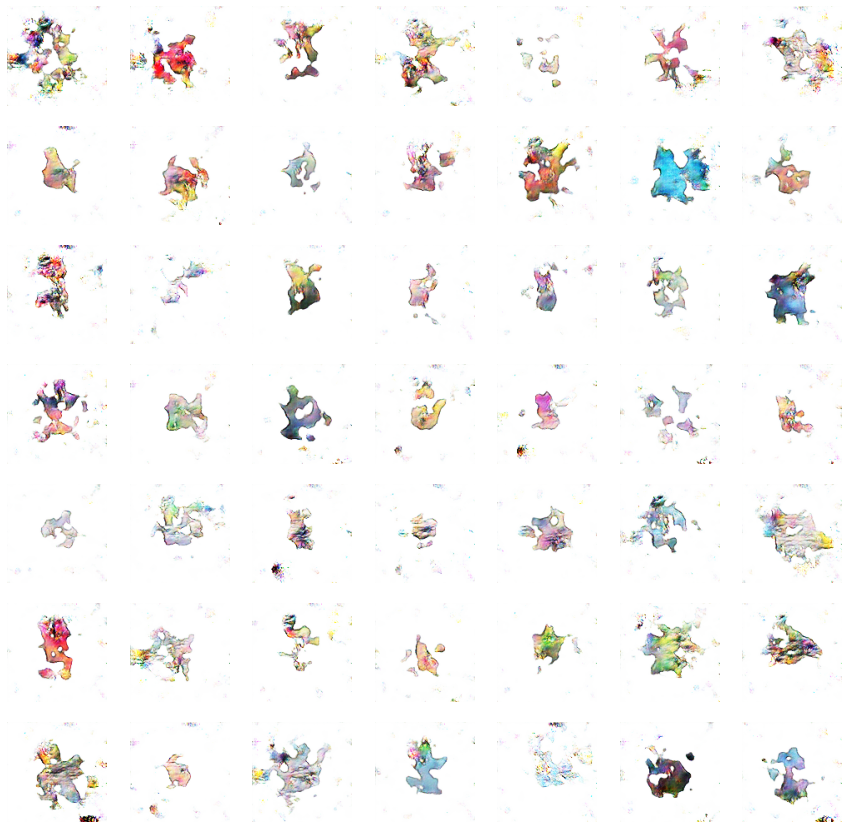

dis loss i
0.17899703979492188 0.1843796968460083 300
dis loss i
0.2800105810165405 0.05528046935796738 301
dis loss i
0.4571606516838074 1.2242658138275146 302
dis loss i
0.1524297595024109 0.24707797169685364 303
dis loss i
0.08475718647241592 0.2566807270050049 304
dis loss i
0.1077764481306076 0.1009649932384491 305
dis loss i
0.08151616156101227 0.17436829209327698 306
dis loss i
0.10574914515018463 0.1259504109621048 307
dis loss i
0.2099621295928955 0.21074435114860535 308
dis loss i
0.1294931322336197 0.33392277359962463 309
dis loss i
0.2591469883918762 0.21075211465358734 310
dis loss i
0.17117547988891602 0.024676252156496048 311
dis loss i
1.2247381210327148 0.7324745655059814 312
dis loss i
0.2403344213962555 0.5754836201667786 313
dis loss i
0.22170031070709229 0.15875697135925293 314
dis loss i
0.18927952647209167 0.20237520337104797 315
dis loss i
0.058243006467819214 0.2856849431991577 316
dis loss i
0.16598081588745117 0.11286240816116333 317
dis loss i
0.183762609958

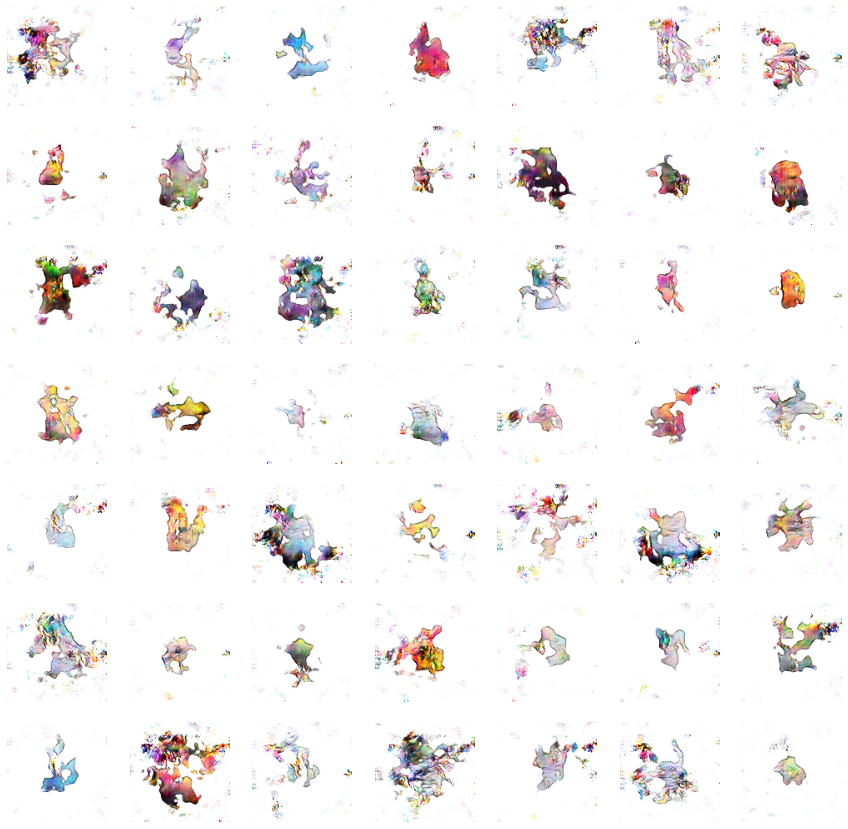

dis loss i
0.21953251957893372 0.04704038426280022 350
dis loss i
0.0857660323381424 0.13432395458221436 351
dis loss i
0.04503922536969185 0.12312562018632889 352
dis loss i
0.05671671777963638 0.10754245519638062 353
dis loss i
0.08856217563152313 0.12979820370674133 354
dis loss i
0.19415046274662018 0.07638613879680634 355
dis loss i
0.13359642028808594 0.2034105509519577 356
dis loss i
0.1333768367767334 0.11718519777059555 357
dis loss i
0.19620518386363983 0.18202005326747894 358
dis loss i
0.07385686784982681 0.04640856757760048 359
dis loss i
0.25928178429603577 0.22083820402622223 360
dis loss i
0.0947200208902359 0.14646652340888977 361
dis loss i
0.16454410552978516 0.14721547067165375 362
dis loss i
0.14887651801109314 0.21508362889289856 363
dis loss i
0.28189224004745483 0.21432897448539734 364
dis loss i
0.5713667869567871 0.6767716407775879 365
dis loss i
0.6786974668502808 0.6716045141220093 366
dis loss i
0.4808836877346039 0.5052369832992554 367
dis loss i
0.3905369

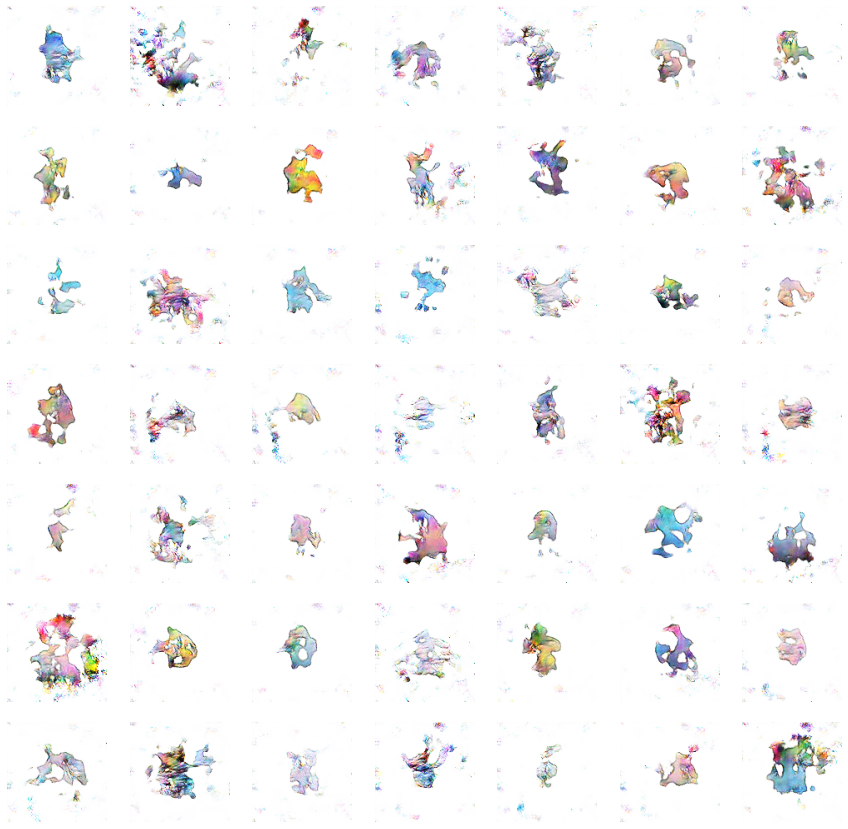

dis loss i
0.043700605630874634 0.042313747107982635 400
dis loss i
0.038107939064502716 0.04107057675719261 401
dis loss i
0.23245303332805634 0.24813085794448853 402
dis loss i
0.0564841702580452 0.20306895673274994 403
dis loss i
0.4800490438938141 0.7866368293762207 404
dis loss i
0.34301429986953735 0.37916672229766846 405
dis loss i
0.37543177604675293 0.4799245595932007 406
dis loss i
0.28285956382751465 0.2010989487171173 407
dis loss i
0.12871931493282318 0.1042754203081131 408
dis loss i
0.13048310577869415 0.09861023724079132 409
dis loss i
0.17640413343906403 0.4370889663696289 410
dis loss i
0.07470109313726425 0.06002352759242058 411
dis loss i
0.05339858680963516 0.24853792786598206 412
dis loss i
0.08179625123739243 0.2964395582675934 413
dis loss i
0.0634438544511795 0.26416754722595215 414
dis loss i
0.2278202623128891 0.2808377742767334 415
dis loss i
0.22938163578510284 0.18066498637199402 416
dis loss i
0.052562814205884933 0.19329890608787537 417
dis loss i
0.0475

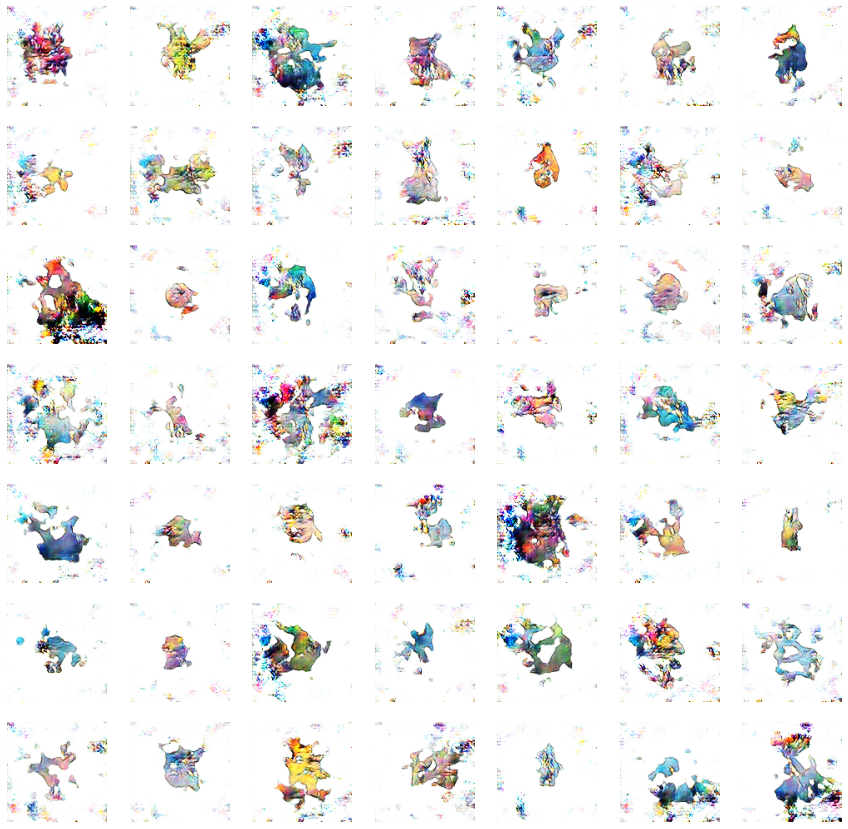

dis loss i
0.38854920864105225 0.33589956164360046 450
dis loss i
0.28136974573135376 0.57616126537323 451
dis loss i
0.3116375207901001 0.3809199035167694 452
dis loss i
0.29902738332748413 0.5027456879615784 453
dis loss i
0.2246381640434265 0.3367713987827301 454
dis loss i
0.2089236080646515 0.24167904257774353 455
dis loss i
0.11125604063272476 0.1484333723783493 456
dis loss i
0.2095905840396881 0.2344597578048706 457
dis loss i
0.16986721754074097 0.16563451290130615 458
dis loss i
0.1614621877670288 0.2229468822479248 459
dis loss i
0.041615843772888184 0.10864817351102829 460
dis loss i
0.14527186751365662 0.13690568506717682 461
dis loss i
0.09595317393541336 0.07723623514175415 462
dis loss i
0.05180220678448677 0.11651235818862915 463
dis loss i
0.15825197100639343 0.17050433158874512 464
dis loss i
0.1532079577445984 0.12929315865039825 465
dis loss i
0.059951528906822205 0.1376611739397049 466
dis loss i
0.11654869467020035 0.16355720162391663 467
dis loss i
0.06343586742

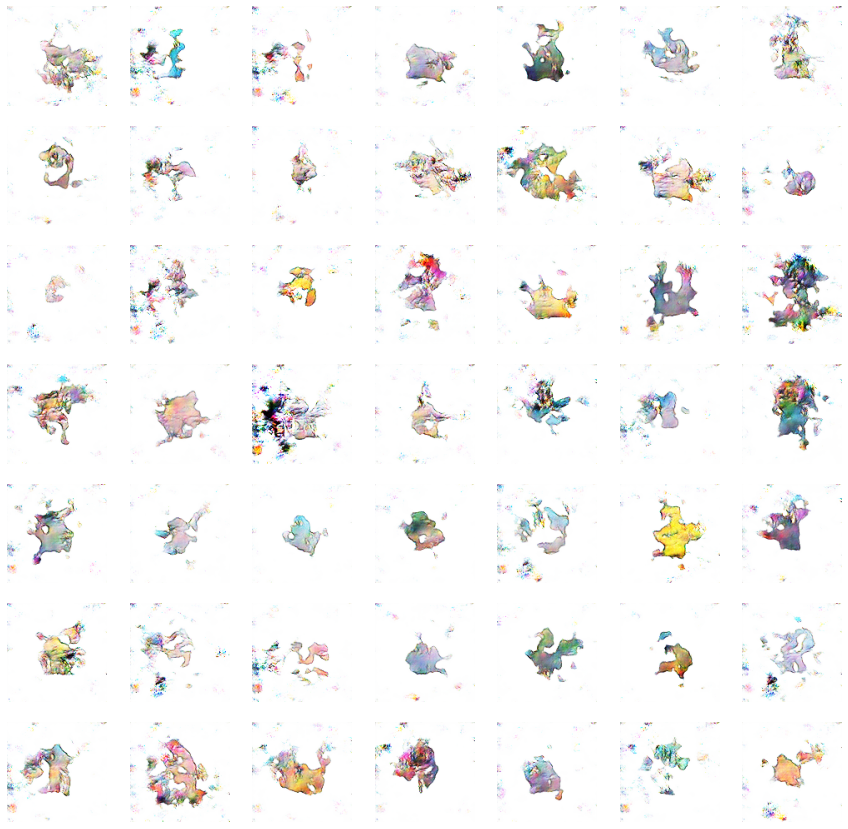

dis loss i
0.05798554793000221 0.056229569017887115 500
dis loss i
0.04097892343997955 0.2409985363483429 501
dis loss i
0.07184646278619766 0.055281028151512146 502
dis loss i
0.2633884847164154 0.4570994973182678 503
dis loss i
0.06040310114622116 0.05649090185761452 504
dis loss i
0.03501644730567932 0.13039150834083557 505
dis loss i
0.07970985770225525 0.13822293281555176 506
dis loss i
0.23126359283924103 0.13222500681877136 507
dis loss i
0.1032184362411499 0.1417788416147232 508
dis loss i
0.17524820566177368 0.22897663712501526 509
dis loss i
0.18294844031333923 0.25518834590911865 510
dis loss i
0.16817618906497955 0.153303325176239 511
dis loss i
0.1278684139251709 0.18045294284820557 512
dis loss i
0.05762174725532532 0.07105240225791931 513
dis loss i
0.12644943594932556 0.04568106681108475 514
dis loss i
0.2544463872909546 0.6249694228172302 515
dis loss i
0.36066216230392456 0.5083469152450562 516
dis loss i
0.15623508393764496 0.18922284245491028 517
dis loss i
0.321215

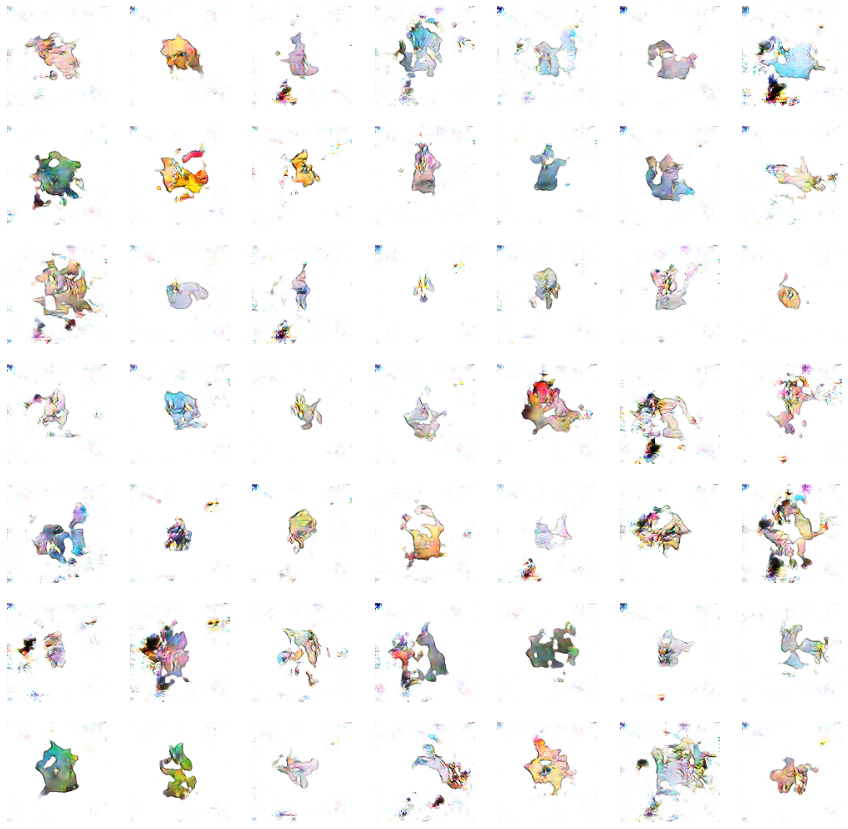

dis loss i
0.01895190216600895 0.16193369030952454 550
dis loss i
0.1660897135734558 0.1903611570596695 551
dis loss i
0.09240272641181946 0.08242529630661011 552
dis loss i
0.036486849188804626 0.1610744595527649 553
dis loss i
0.21530169248580933 0.38823598623275757 554
dis loss i
0.055720098316669464 0.4605896472930908 555
dis loss i
0.07311443984508514 0.03851671889424324 556
dis loss i
0.022603441029787064 0.0645865947008133 557
dis loss i
0.1441771388053894 0.18885529041290283 558
dis loss i
0.11625416576862335 0.20643864572048187 559
dis loss i
0.08823030441999435 0.03790726512670517 560
dis loss i
0.2221710979938507 0.11174237728118896 561
dis loss i
0.0576479509472847 0.05808764323592186 562
dis loss i
0.10320882499217987 0.40173423290252686 563
dis loss i
0.07876119017601013 0.027405008673667908 564
dis loss i
0.0398249477148056 0.11471584439277649 565
dis loss i
0.17209205031394958 0.31461042165756226 566
dis loss i
0.01988041028380394 0.15001574158668518 567
dis loss i
0.08

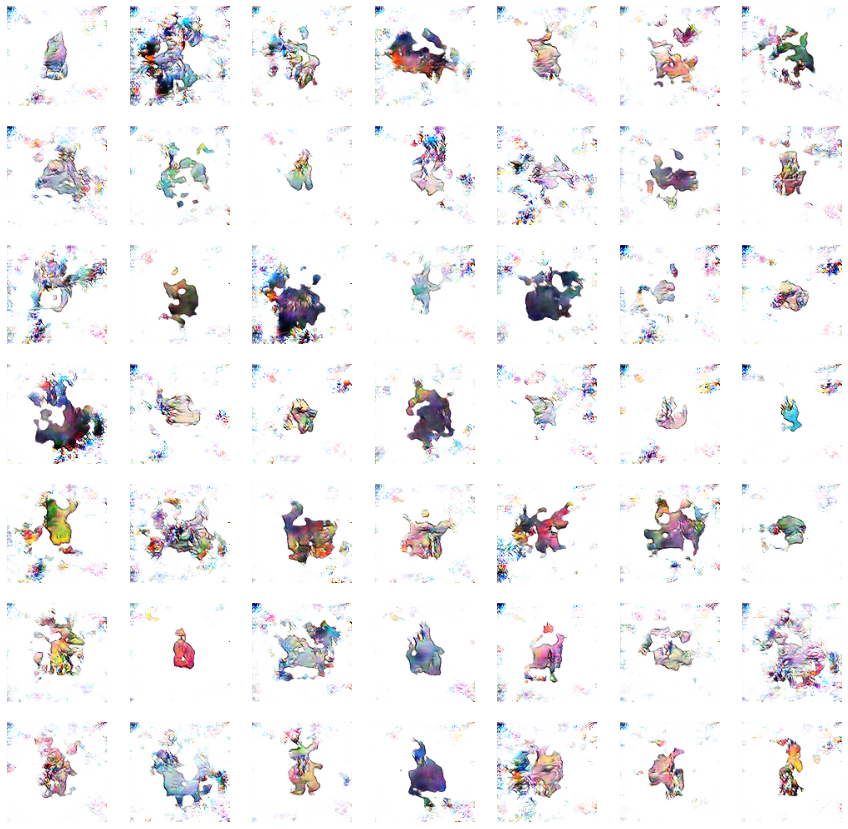

dis loss i
0.3254684507846832 0.40881580114364624 600
dis loss i
0.28192269802093506 0.49771517515182495 601
dis loss i
0.42643576860427856 0.9847811460494995 602
dis loss i
0.2546299993991852 0.1867576241493225 603
dis loss i
0.2720321714878082 0.16389107704162598 604
dis loss i
0.19723260402679443 0.49580106139183044 605
dis loss i
0.12477822601795197 0.18144598603248596 606
dis loss i
0.21771575510501862 0.08932319283485413 607
dis loss i
0.3780789077281952 0.499839186668396 608
dis loss i
0.11564644426107407 0.09981952607631683 609
dis loss i
0.5506266951560974 0.6299426555633545 610
dis loss i
0.07226338237524033 0.10464467108249664 611
dis loss i
0.08819480240345001 0.06868897378444672 612
dis loss i
0.040529921650886536 0.09252023696899414 613
dis loss i
0.05067017674446106 0.031604841351509094 614
dis loss i
0.03663170710206032 0.024207375943660736 615
dis loss i
0.13185255229473114 0.07267137616872787 616
dis loss i
0.043727751821279526 0.03340627998113632 617
dis loss i
0.111

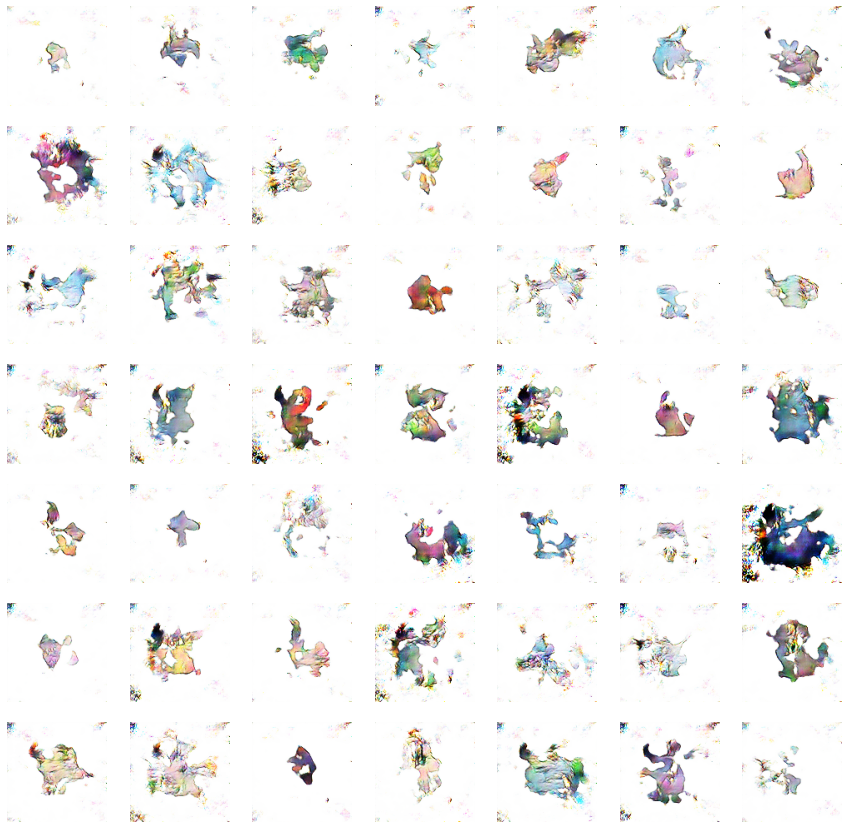

dis loss i
0.06461712718009949 0.14914602041244507 650
dis loss i
0.1202152743935585 0.10592865943908691 651
dis loss i
0.10599388182163239 0.006759005133062601 652
dis loss i
0.12289460748434067 0.12435875833034515 653
dis loss i
0.01552334800362587 0.1483716368675232 654
dis loss i
0.041746459901332855 0.12690740823745728 655
dis loss i
0.023528974503278732 0.018300743773579597 656
dis loss i
0.04263988137245178 0.05211324989795685 657
dis loss i
0.09938361495733261 0.33371207118034363 658
dis loss i
0.04797552525997162 0.09450353682041168 659
dis loss i
0.04302993416786194 0.040653251111507416 660
dis loss i
0.09379860758781433 0.19631022214889526 661
dis loss i
0.04003811627626419 0.13755401968955994 662
dis loss i
0.09470271319150925 0.1451123058795929 663
dis loss i
0.028641430661082268 0.14673767983913422 664
dis loss i
0.043644968420267105 0.13509857654571533 665
dis loss i
0.022903844714164734 0.012855177745223045 666
dis loss i
0.008720902726054192 0.013525880873203278 667
di

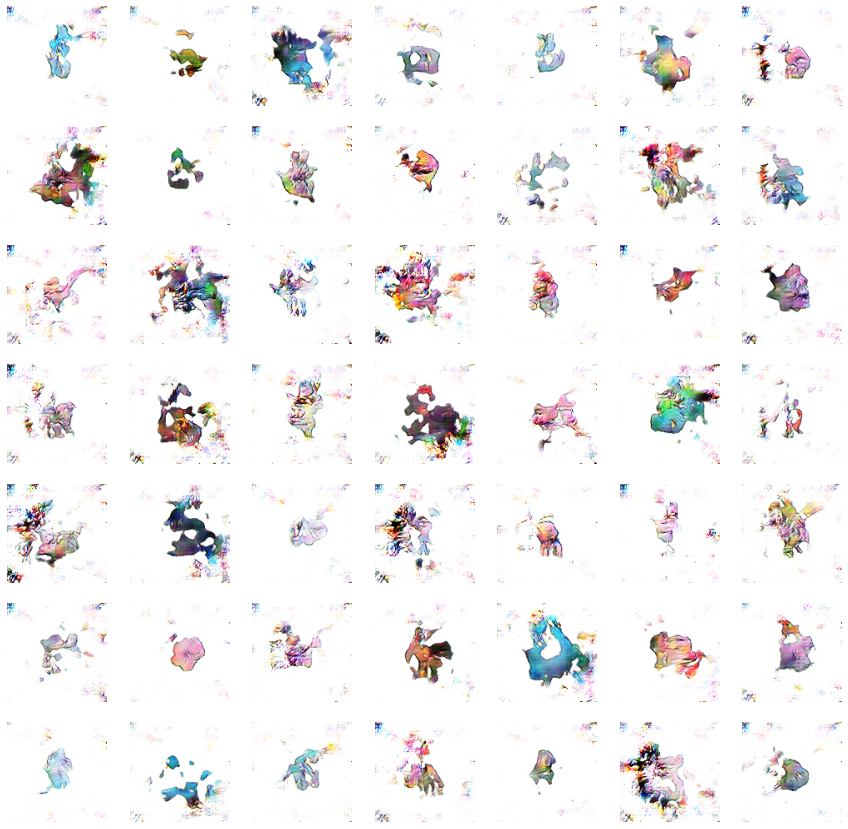

dis loss i
0.6061400175094604 0.5356762409210205 700
dis loss i
0.5679364204406738 0.4858028292655945 701
dis loss i
0.5480589866638184 0.6381765604019165 702
dis loss i
0.5468528866767883 0.5989453196525574 703
dis loss i
0.5661165714263916 0.5195966958999634 704
dis loss i
0.546177864074707 0.6388416886329651 705
dis loss i
0.46953141689300537 0.7008461356163025 706
dis loss i
0.5040866136550903 0.6550023555755615 707
dis loss i
0.5067315101623535 0.586733341217041 708
dis loss i
0.5475900769233704 0.6237265467643738 709
dis loss i
0.5659220814704895 0.6154651641845703 710
dis loss i
0.47661513090133667 0.49350863695144653 711
dis loss i
0.5089038014411926 0.5285353660583496 712
dis loss i
0.4824332594871521 0.6627405881881714 713
dis loss i
0.5060621500015259 0.4028846025466919 714
dis loss i
0.44136691093444824 0.611112654209137 715
dis loss i
0.46710067987442017 0.5865168571472168 716
dis loss i
0.36698710918426514 0.5333212018013 717
dis loss i
0.4596896171569824 0.55409312248229

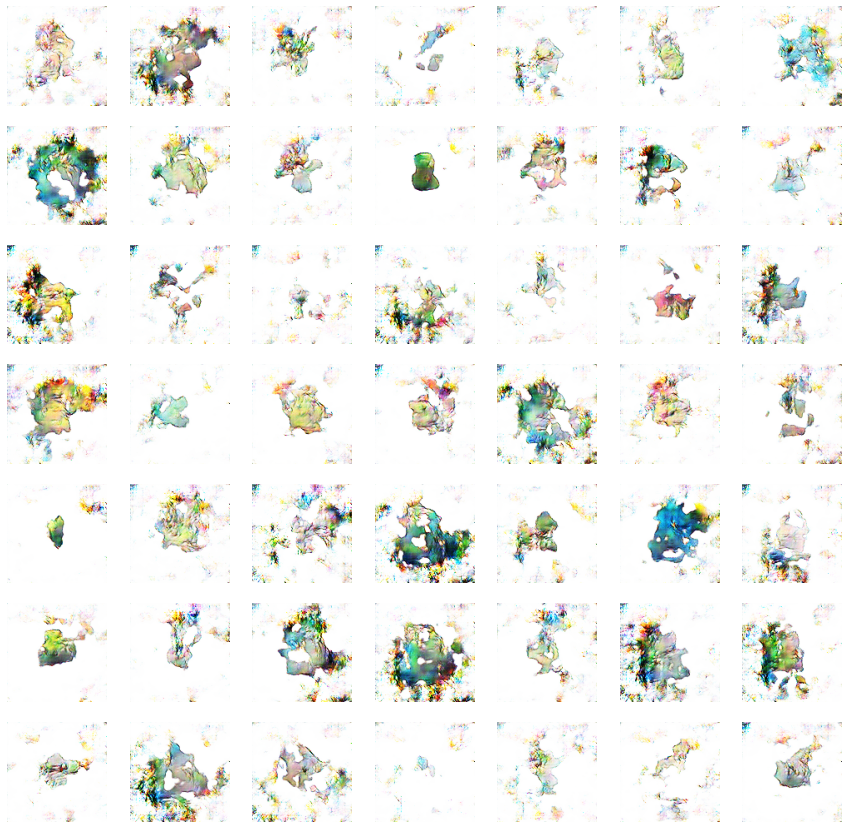

dis loss i
0.11375076323747635 0.24906513094902039 750
dis loss i
0.28309208154678345 0.17667004466056824 751
dis loss i
0.033794328570365906 0.29168808460235596 752
dis loss i
0.23551034927368164 0.140414759516716 753
dis loss i
0.1697579026222229 0.2818303406238556 754
dis loss i
0.08523523807525635 0.09723122417926788 755
dis loss i
0.21094919741153717 0.2718436121940613 756
dis loss i
0.1356356292963028 0.18919125199317932 757
dis loss i
0.08606313169002533 0.049185141921043396 758
dis loss i
0.23504066467285156 0.2847864627838135 759
dis loss i
0.13680842518806458 0.511918842792511 760
dis loss i
0.04923971742391586 0.0849338173866272 761
dis loss i
0.04523066058754921 0.13931362330913544 762
dis loss i
0.04781530052423477 0.12416740506887436 763
dis loss i
0.0723605751991272 0.20629923045635223 764
dis loss i
0.1391795426607132 0.1941254436969757 765
dis loss i
0.26485490798950195 0.21529144048690796 766
dis loss i
0.19481372833251953 0.15280026197433472 767
dis loss i
0.13386924

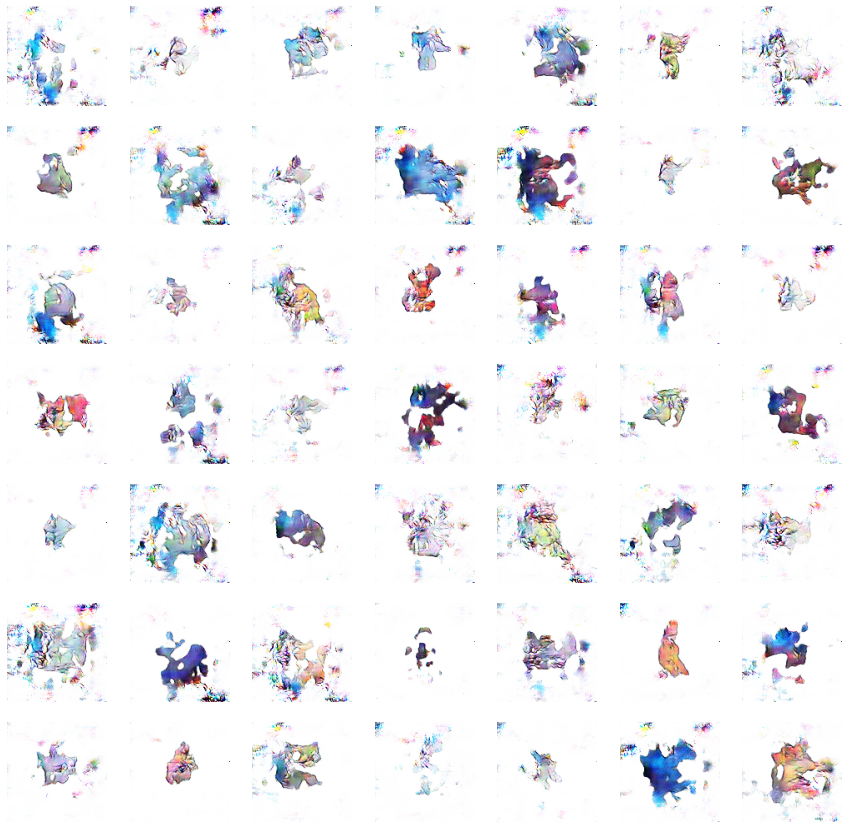

dis loss i
0.03519335761666298 0.1408022791147232 800
dis loss i
0.03442354127764702 0.011699127033352852 801
dis loss i
0.022633779793977737 0.0628550797700882 802
dis loss i
0.08374302089214325 0.03700442612171173 803
dis loss i
0.24634668231010437 0.10915073752403259 804
dis loss i
0.04217508062720299 0.037609606981277466 805
dis loss i
0.0984489694237709 0.1373133510351181 806
dis loss i
0.027382466942071915 0.1511237472295761 807
dis loss i
0.05933556333184242 0.20985226333141327 808
dis loss i
0.07219205051660538 0.08545950055122375 809
dis loss i
0.044723886996507645 0.024497613310813904 810
dis loss i
0.05447142571210861 0.12109130620956421 811
dis loss i
0.09896721690893173 0.2884708344936371 812
dis loss i
0.0642707347869873 0.25447455048561096 813
dis loss i
0.08259209990501404 0.08253351598978043 814
dis loss i
0.08441270887851715 0.03323707357048988 815
dis loss i
0.02017756551504135 0.02134743705391884 816
dis loss i
0.28951019048690796 0.1477052867412567 817
dis loss i
0

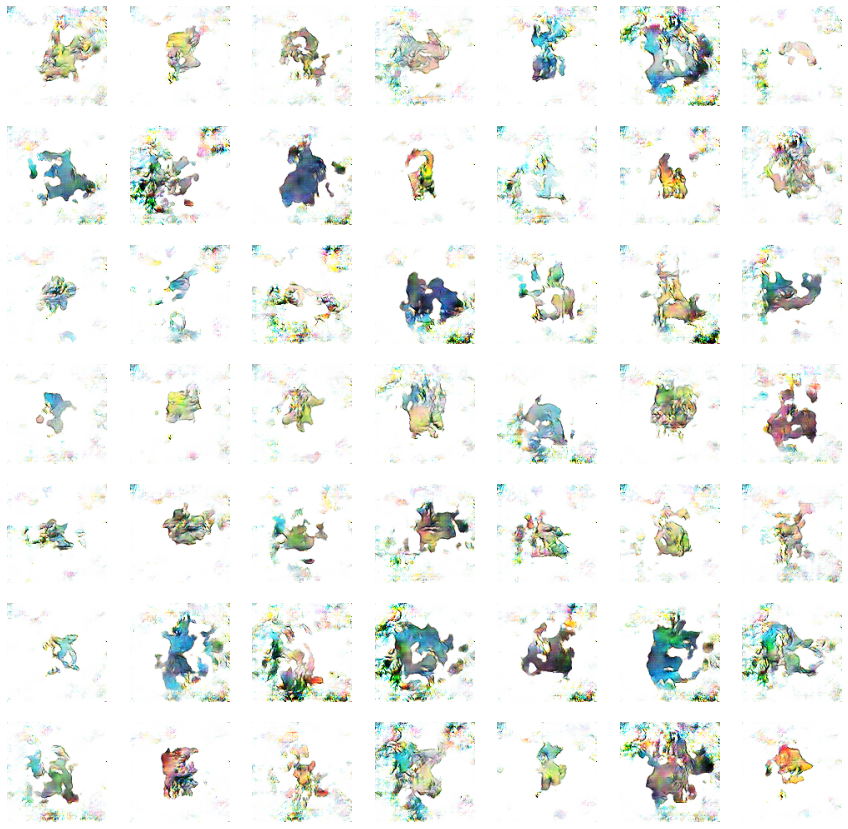

dis loss i
0.03600072115659714 0.08648271858692169 850
dis loss i
0.050578825175762177 0.15818384289741516 851
dis loss i
0.11490005254745483 0.147668719291687 852
dis loss i
0.12653851509094238 0.1028728187084198 853
dis loss i
0.06592239439487457 0.028272908180952072 854
dis loss i
0.0399315282702446 0.13212794065475464 855
dis loss i
0.06141868978738785 0.17718076705932617 856
dis loss i
0.042661890387535095 0.027640169486403465 857
dis loss i
0.18131506443023682 0.20306581258773804 858
dis loss i
0.010974972508847713 0.09845176339149475 859
dis loss i
0.04353204369544983 0.05605662614107132 860
dis loss i
0.04140974581241608 0.09895841032266617 861
dis loss i
0.07310532033443451 0.07218571752309799 862
dis loss i
0.047261886298656464 0.26415887475013733 863
dis loss i
0.032058797776699066 0.06120915710926056 864
dis loss i
0.11631973087787628 0.034765779972076416 865
dis loss i
0.0381423719227314 0.09582889825105667 866
dis loss i
0.040402766317129135 0.036431167274713516 867
dis l

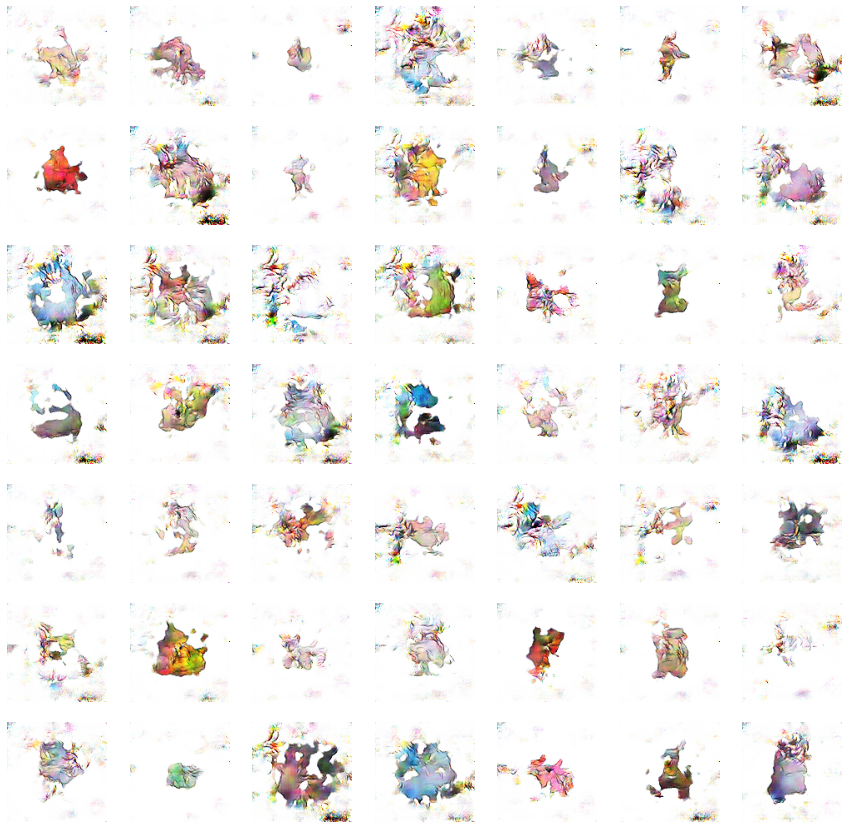

dis loss i
0.020507510751485825 0.059458427131175995 900
dis loss i
0.013496877625584602 0.18127521872520447 901
dis loss i
0.04717720299959183 0.05667894706130028 902
dis loss i
0.09165415167808533 0.042444147169589996 903
dis loss i
0.028957614675164223 0.039198338985443115 904
dis loss i
0.24113604426383972 0.03178418427705765 905
dis loss i
0.06389757990837097 0.07244225591421127 906
dis loss i
0.04290071129798889 0.04218076914548874 907
dis loss i
0.01196609903126955 0.04062312841415405 908
dis loss i
0.010592265985906124 0.049591585993766785 909
dis loss i
0.04919355362653732 0.02916448935866356 910
dis loss i
0.06198231875896454 0.08907783031463623 911
dis loss i
0.06153353303670883 0.02943134307861328 912
dis loss i
0.002739662304520607 0.16042974591255188 913
dis loss i
0.037817321717739105 0.050162989646196365 914
dis loss i
0.07825908064842224 0.07200253009796143 915
dis loss i
0.7746874094009399 0.986710786819458 916
dis loss i
0.2001120150089264 0.1530463844537735 917
dis 

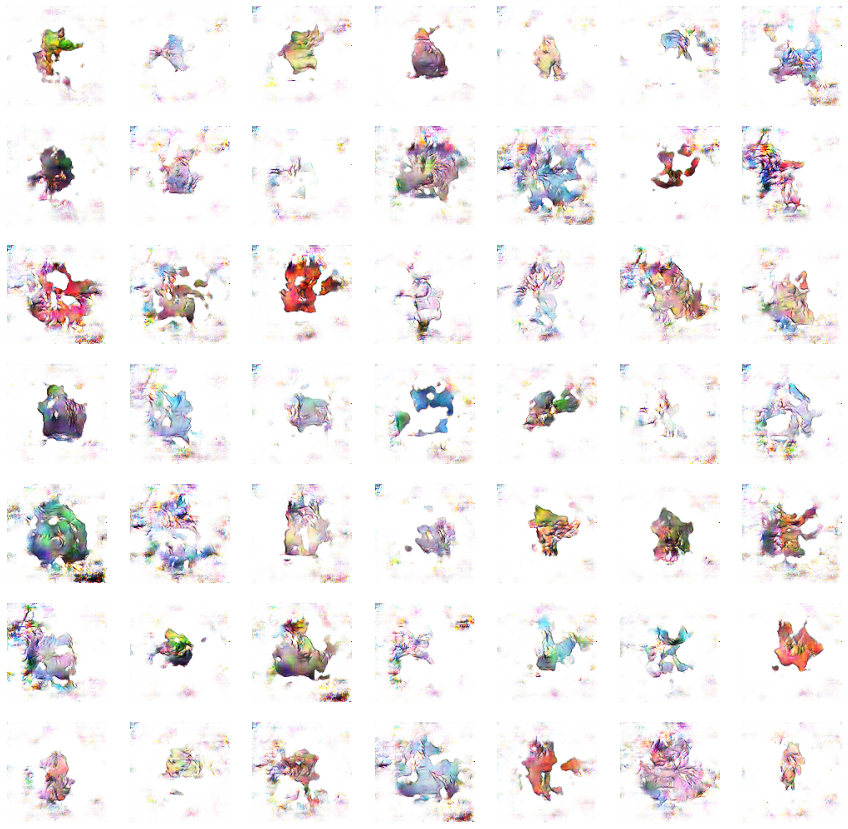

dis loss i
0.07574579119682312 0.07268181443214417 950
dis loss i
0.05461081862449646 0.0348496288061142 951
dis loss i
0.05368528142571449 0.1756218671798706 952
dis loss i
0.014051046222448349 0.054369233548641205 953
dis loss i
0.026282308623194695 0.03998403251171112 954
dis loss i
0.10050234198570251 0.015577597543597221 955
dis loss i
0.0641608014702797 0.16896645724773407 956
dis loss i
0.053580351173877716 0.06589807569980621 957
dis loss i
0.04397787153720856 0.015864698216319084 958
dis loss i
0.07409913092851639 0.16270923614501953 959
dis loss i
0.06971517205238342 0.11016819626092911 960
dis loss i
0.0384744256734848 0.09621628373861313 961
dis loss i
0.12909168004989624 0.23653501272201538 962
dis loss i
0.09831471741199493 0.14294785261154175 963
dis loss i
0.03268459439277649 0.07533109188079834 964
dis loss i
0.027242174372076988 0.03615090996026993 965
dis loss i
0.011940626427531242 0.10500985383987427 966
dis loss i
0.03793707489967346 0.015274452045559883 967
dis l

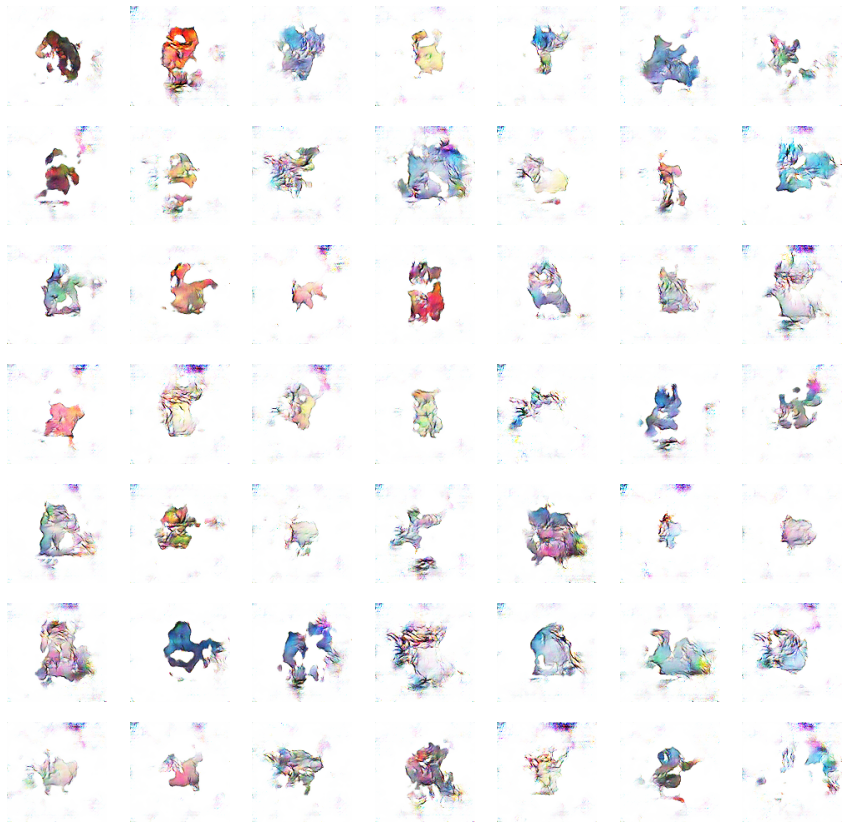

dis loss i
0.06747285276651382 0.10488301515579224 1000
dis loss i
0.031834427267313004 0.061346761882305145 1001
dis loss i
0.012647738680243492 0.22096382081508636 1002
dis loss i
0.024437837302684784 0.03562236949801445 1003
dis loss i
0.013808492571115494 0.06364134699106216 1004
dis loss i
0.023349840193986893 0.027439091354608536 1005
dis loss i
0.006358986720442772 0.13927458226680756 1006
dis loss i
0.16889804601669312 0.05051198601722717 1007
dis loss i
0.030280761420726776 0.04053908586502075 1008
dis loss i
0.060203712433576584 0.015785256400704384 1009
dis loss i
0.00670549925416708 0.13130629062652588 1010
dis loss i
0.10735367983579636 0.5351378917694092 1011
dis loss i
0.24052734673023224 0.2137298285961151 1012
dis loss i
0.032859183847904205 0.21093304455280304 1013
dis loss i
0.031657978892326355 0.018780289217829704 1014
dis loss i
0.028661560267210007 0.11588388681411743 1015
dis loss i
0.034368451684713364 0.14052730798721313 1016
dis loss i
0.0365971103310585 0.08

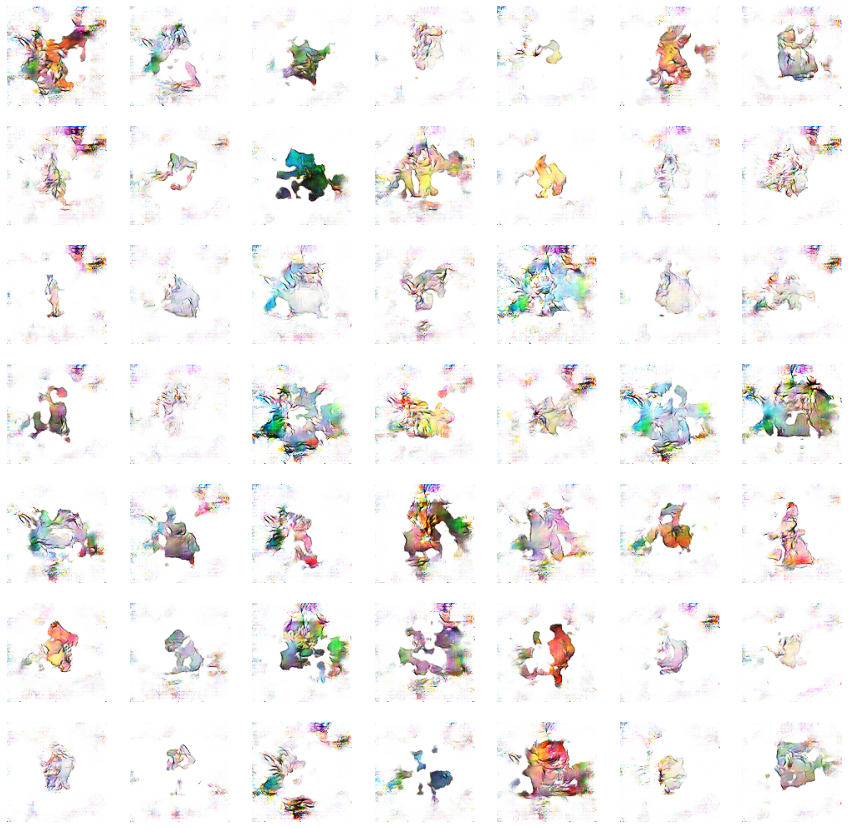

dis loss i
0.0690091922879219 0.05010299012064934 1050
dis loss i
0.014944728463888168 0.013362990692257881 1051
dis loss i
0.005739407613873482 0.11725509911775589 1052
dis loss i
0.10144558548927307 0.06226293742656708 1053
dis loss i
0.01973780058324337 0.03639383986592293 1054
dis loss i
0.26921746134757996 0.2914426922798157 1055
dis loss i
0.10436470806598663 0.17827057838439941 1056
dis loss i
0.04328364133834839 0.021935313940048218 1057
dis loss i
0.11304731667041779 0.16279801726341248 1058
dis loss i
0.1748732030391693 0.09759573638439178 1059
dis loss i
0.01868179813027382 0.021786389872431755 1060
dis loss i
0.06400781869888306 0.1168680265545845 1061
dis loss i
0.012086446397006512 0.023907560855150223 1062
dis loss i
0.4053155779838562 0.5881731510162354 1063
dis loss i
0.213364377617836 0.07906392216682434 1064
dis loss i
0.04093627631664276 0.2445090115070343 1065
dis loss i
0.023042939603328705 0.0759110301733017 1066
dis loss i
0.37300047278404236 0.9111924171447754 

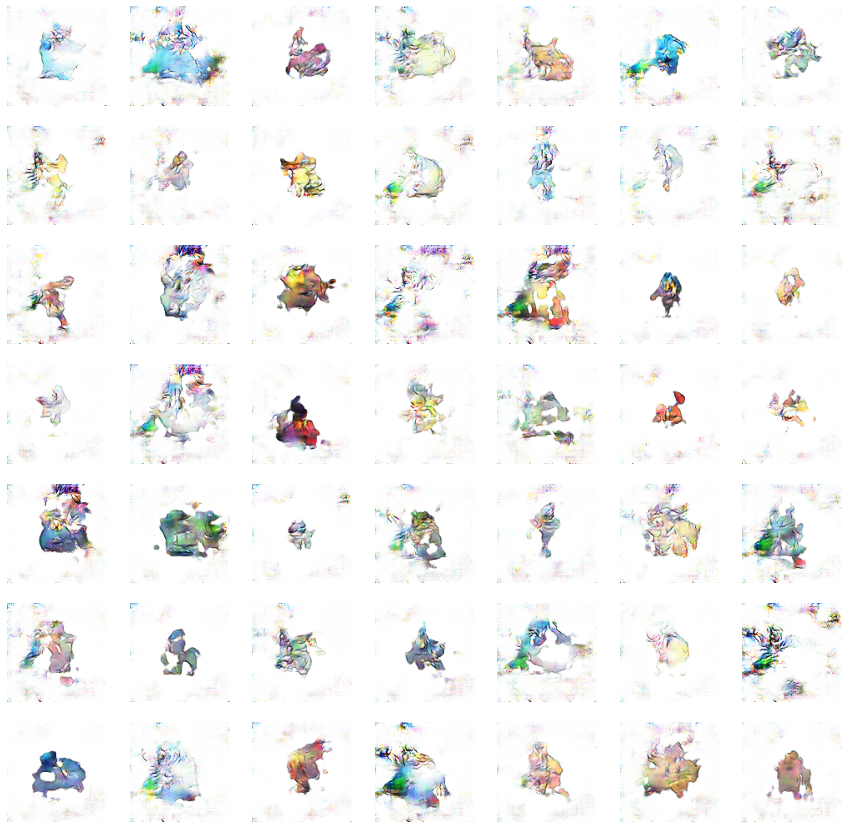

dis loss i
0.4137570559978485 0.1710718274116516 1100
dis loss i
0.08900506794452667 0.11410927772521973 1101
dis loss i
0.007953552529215813 0.16416141390800476 1102
dis loss i
0.14663875102996826 0.03678903728723526 1103
dis loss i
0.06019706651568413 0.22702643275260925 1104
dis loss i
0.00581878237426281 0.12412535399198532 1105
dis loss i
0.06874597072601318 0.006980178877711296 1106
dis loss i
0.008240191265940666 0.12428348511457443 1107
dis loss i
0.006283948663622141 0.1408405601978302 1108
dis loss i
0.19886091351509094 0.1282217651605606 1109
dis loss i
0.17010653018951416 0.05791526660323143 1110
dis loss i
0.035639770328998566 0.010926085524260998 1111
dis loss i
0.02709505334496498 0.10553786903619766 1112
dis loss i
0.0676381066441536 0.08981792628765106 1113
dis loss i
0.07831743359565735 0.007729534991085529 1114
dis loss i
0.031782396137714386 0.008653338998556137 1115
dis loss i
0.0541599802672863 0.15259034931659698 1116
dis loss i
0.0076764714904129505 0.0516993068

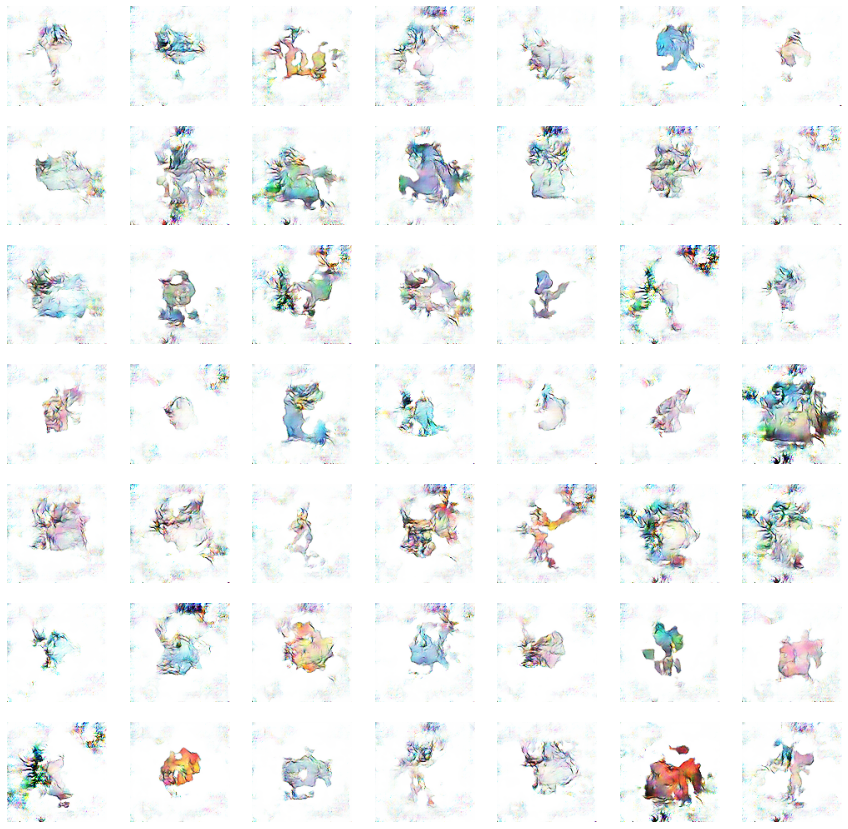

dis loss i
0.1583850085735321 0.4685326814651489 1150
dis loss i
0.22354353964328766 0.21038973331451416 1151
dis loss i
0.34622442722320557 0.5072365403175354 1152
dis loss i
0.24437564611434937 0.09757901728153229 1153
dis loss i
0.0358806848526001 0.06613432615995407 1154
dis loss i
0.10584544390439987 0.0933326855301857 1155
dis loss i
0.13799960911273956 0.17832878232002258 1156
dis loss i
0.041070606559515 0.026253627613186836 1157
dis loss i
0.02534608729183674 0.10668954998254776 1158
dis loss i
0.019322168081998825 0.03178926929831505 1159
dis loss i
0.11109095066785812 0.13473813235759735 1160
dis loss i
0.16173329949378967 0.012141411192715168 1161
dis loss i
0.1277768611907959 0.17765703797340393 1162
dis loss i
0.07810042053461075 0.13530458509922028 1163
dis loss i
0.013058913871645927 0.1070479303598404 1164
dis loss i
0.08248229324817657 0.011931145563721657 1165
dis loss i
0.02364530600607395 0.013601434417068958 1166
dis loss i
0.0400298610329628 0.06478872895240784 1

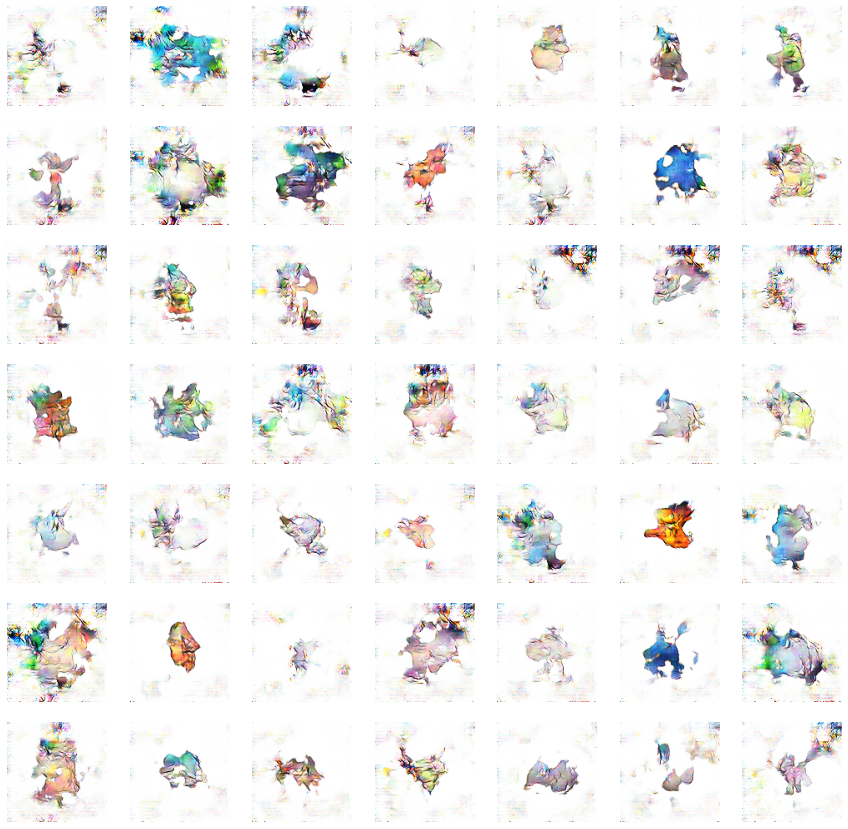

dis loss i
0.013351496309041977 0.015807798132300377 1200
dis loss i
0.01912776380777359 0.020158890634775162 1201
dis loss i
0.2540251910686493 0.2762141227722168 1202
dis loss i
0.018397316336631775 0.03131861239671707 1203
dis loss i
0.010298626497387886 0.040779583156108856 1204
dis loss i
0.0266957376152277 0.03418706730008125 1205
dis loss i
0.017642997205257416 0.002369990572333336 1206
dis loss i
0.013536517508327961 0.007100939750671387 1207
dis loss i
0.07954569905996323 0.13337883353233337 1208
dis loss i
0.01851479895412922 0.00820978358387947 1209
dis loss i
0.008890403434634209 0.01654001697897911 1210
dis loss i
0.00438379542902112 0.1784483790397644 1211
dis loss i
0.012760074809193611 0.01707732304930687 1212
dis loss i
0.10921528935432434 0.012108912691473961 1213
dis loss i
0.02998838946223259 0.011064129881560802 1214
dis loss i
0.0054953256621956825 0.350909024477005 1215
dis loss i
0.04228820279240608 0.19364532828330994 1216
dis loss i
0.01661258563399315 0.00293

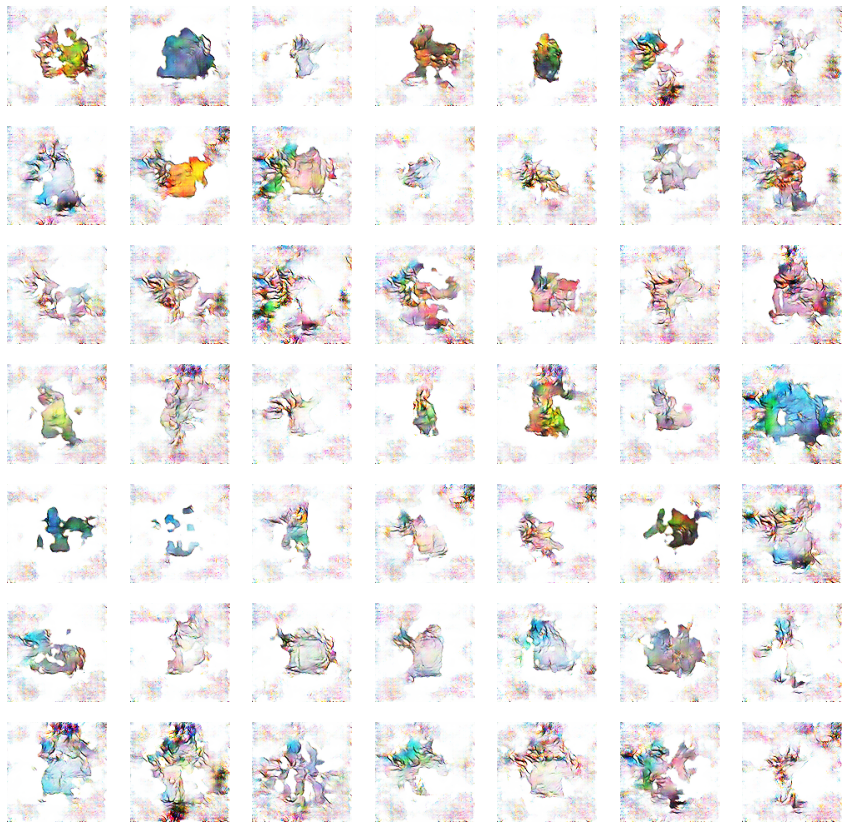

dis loss i
0.061857692897319794 0.02943021059036255 1250
dis loss i
0.03957129642367363 0.06374035030603409 1251
dis loss i
0.01771148294210434 0.10820814967155457 1252
dis loss i
0.025732889771461487 0.088526152074337 1253
dis loss i
0.010942799039185047 0.0879632905125618 1254
dis loss i
0.09567920863628387 0.04730135202407837 1255
dis loss i
0.00653877854347229 0.0199211947619915 1256
dis loss i
0.04639443755149841 0.10319602489471436 1257
dis loss i
0.0013257458340376616 0.024748455733060837 1258
dis loss i
0.033010710030794144 0.08405038714408875 1259
dis loss i
0.0835530161857605 0.09928067028522491 1260
dis loss i
0.01701575331389904 0.10057396441698074 1261
dis loss i
0.06502456963062286 0.044008273631334305 1262
dis loss i
0.004283340647816658 0.003029818646609783 1263
dis loss i
0.018794408068060875 0.003215461503714323 1264
dis loss i
0.12307199835777283 0.19921664893627167 1265
dis loss i
0.06554330885410309 0.1216312050819397 1266
dis loss i
0.010470579378306866 0.00462583

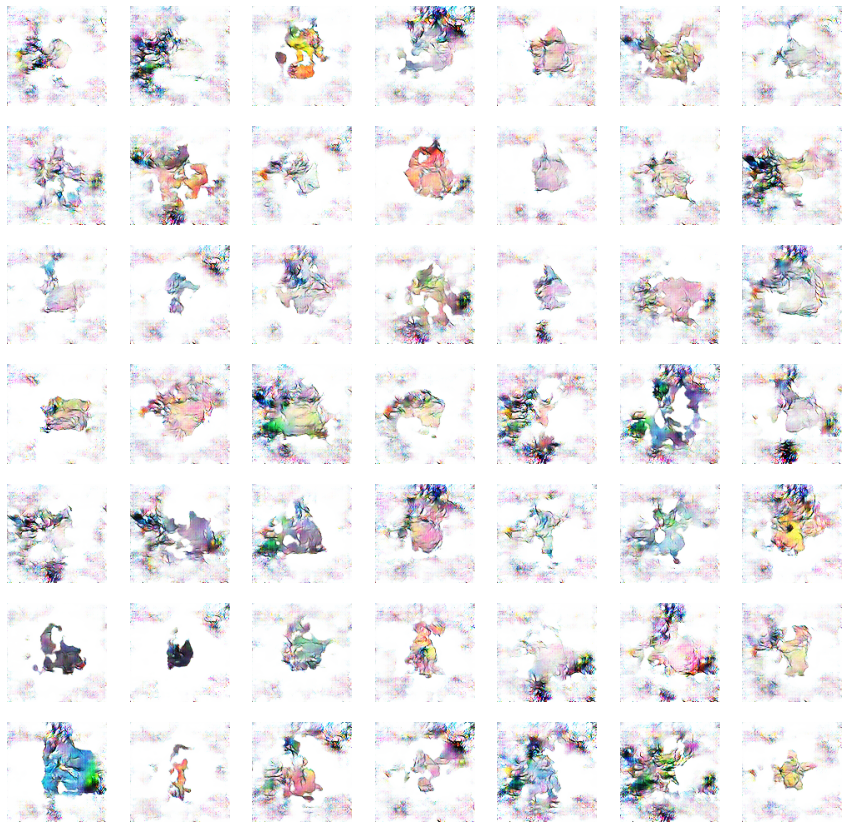

dis loss i
0.2587665617465973 0.34492459893226624 1300
dis loss i
0.19547158479690552 0.4179437458515167 1301
dis loss i
0.14801985025405884 0.18251007795333862 1302
dis loss i
0.1848907470703125 0.24676388502120972 1303
dis loss i
0.33190762996673584 0.26119959354400635 1304
dis loss i
0.12898367643356323 0.2952079176902771 1305
dis loss i
0.11540605872869492 0.3727126121520996 1306
dis loss i
0.21450182795524597 0.14382286369800568 1307
dis loss i
0.1710093468427658 0.11960963904857635 1308
dis loss i
0.16333451867103577 0.19626420736312866 1309
dis loss i
0.33083224296569824 0.5408898591995239 1310
dis loss i
0.0909341424703598 0.14219045639038086 1311
dis loss i
0.029803670942783356 0.06854349374771118 1312
dis loss i
0.02064868062734604 0.2203703224658966 1313
dis loss i
0.4349909722805023 0.48993512988090515 1314
dis loss i
0.1386450231075287 0.10196041315793991 1315
dis loss i
0.028544586151838303 0.04889298602938652 1316
dis loss i
0.10556382685899734 0.12280698120594025 1317
d

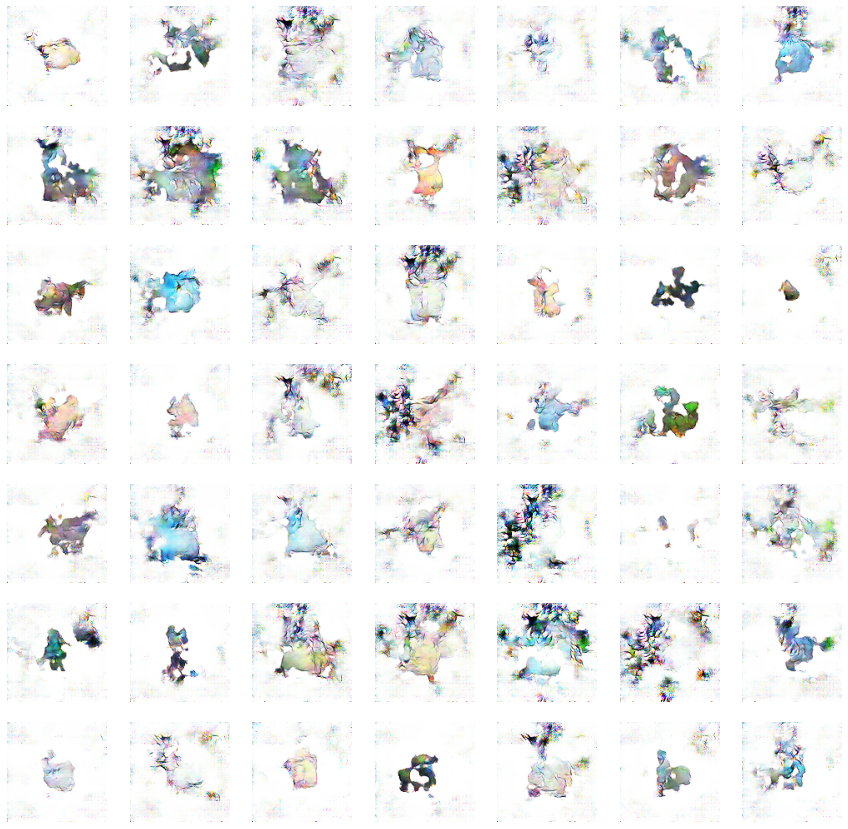

dis loss i
0.08728581666946411 0.009320639073848724 1350
dis loss i
0.006441407836973667 0.07473275065422058 1351
dis loss i
0.02286454290151596 0.053833089768886566 1352
dis loss i
0.06653855741024017 0.06277485191822052 1353
dis loss i
0.024800997227430344 0.08693639189004898 1354
dis loss i
0.019088376313447952 0.14135490357875824 1355
dis loss i
0.012124333530664444 0.017367694526910782 1356
dis loss i
0.0674191564321518 0.04458150267601013 1357
dis loss i
0.020521553233265877 0.026003943756222725 1358
dis loss i
0.013480828143656254 0.003044605953618884 1359
dis loss i
0.05388079211115837 0.00831241812556982 1360
dis loss i
0.008399277925491333 0.04307006299495697 1361
dis loss i
0.008820372633635998 0.2289167046546936 1362
dis loss i
0.24160635471343994 0.429322749376297 1363
dis loss i
0.13618674874305725 0.18629957735538483 1364
dis loss i
0.1324988603591919 0.06546533107757568 1365
dis loss i
0.012965211644768715 0.029764298349618912 1366
dis loss i
0.03187312185764313 0.05930

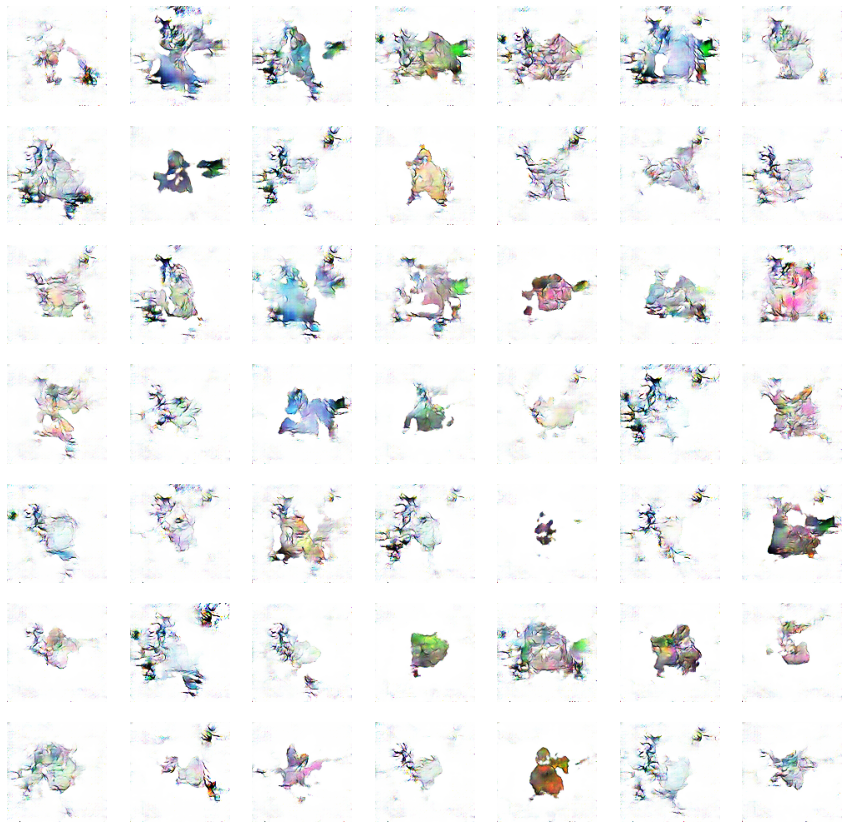

dis loss i
0.011012360453605652 0.018297653645277023 1400
dis loss i
0.03269704431295395 0.006913249380886555 1401
dis loss i
0.004675101023167372 0.026282338425517082 1402
dis loss i
0.0030564460903406143 0.002787230536341667 1403
dis loss i
0.004824301693588495 0.12085989862680435 1404
dis loss i
0.024492371827363968 0.015868455171585083 1405
dis loss i
0.12056337296962738 0.009620369412004948 1406
dis loss i
0.028649091720581055 0.011087371036410332 1407
dis loss i
0.05785074830055237 0.06289723515510559 1408
dis loss i
0.026786722242832184 0.001358249457553029 1409
dis loss i
0.03456193953752518 0.017763003706932068 1410
dis loss i
0.005798219703137875 0.020326917991042137 1411
dis loss i
0.010449463501572609 0.002749977633357048 1412
dis loss i
0.07762850075960159 0.26383548974990845 1413
dis loss i
0.12805774807929993 0.09148779511451721 1414
dis loss i
0.10861290991306305 0.11419014632701874 1415
dis loss i
0.0263548344373703 0.02591848187148571 1416
dis loss i
0.018209245055913

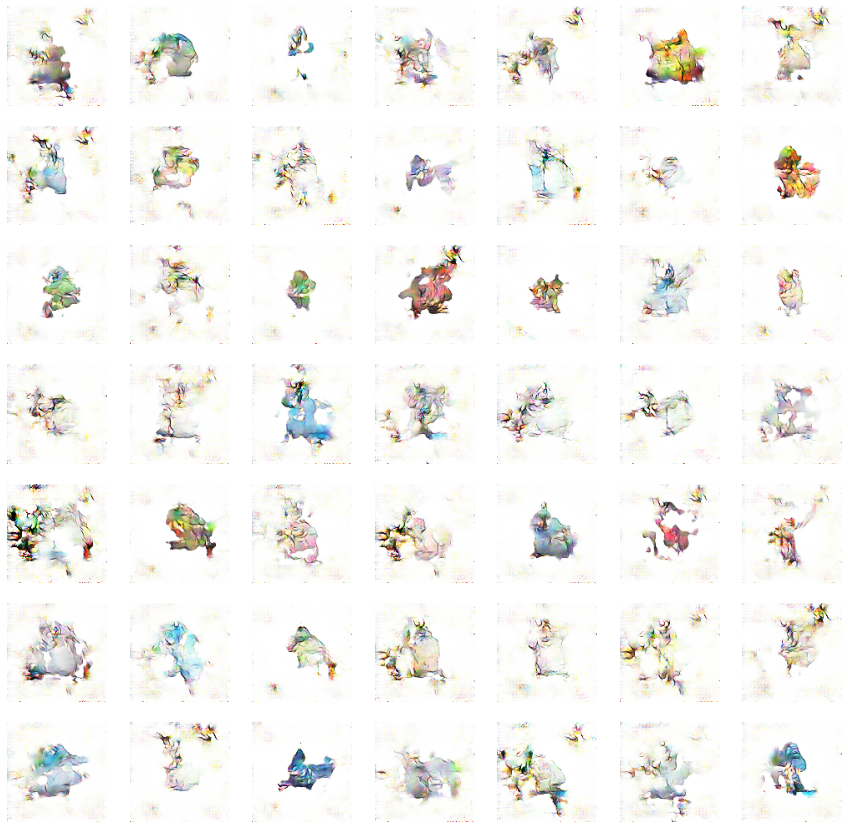

dis loss i
0.04851052537560463 0.13116712868213654 1450
dis loss i
0.010604683309793472 0.022559838369488716 1451
dis loss i
0.0038509026635438204 0.06180339306592941 1452
dis loss i
0.038881778717041016 0.015462100505828857 1453
dis loss i
0.015535197220742702 0.055830784142017365 1454
dis loss i
0.018009483814239502 0.017959095537662506 1455
dis loss i
0.020127639174461365 0.1856444925069809 1456
dis loss i
0.004165781661868095 0.05235007777810097 1457
dis loss i
0.037769485265016556 0.014241062104701996 1458
dis loss i
0.04605548828840256 0.07534770667552948 1459
dis loss i
0.1246231198310852 0.07725302875041962 1460
dis loss i
0.0067955744452774525 0.0017834595637395978 1461
dis loss i
0.012987866997718811 0.02023749239742756 1462
dis loss i
0.0040265475399792194 0.021362842991948128 1463
dis loss i
0.004167500883340836 0.011073978617787361 1464
dis loss i
0.04112592339515686 0.015462901443243027 1465
dis loss i
0.019106347113847733 0.003480616956949234 1466
dis loss i
0.0159019976

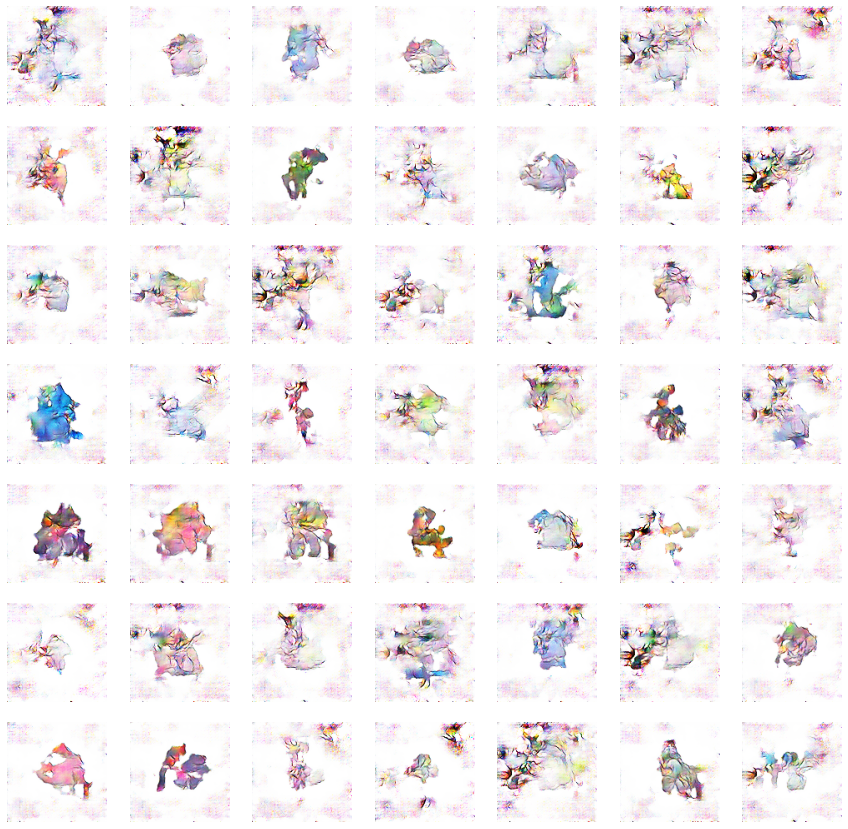

dis loss i
0.002895244862884283 0.10311102867126465 1500
dis loss i
0.01675354316830635 0.046824656426906586 1501
dis loss i
0.03722523897886276 0.004731688182801008 1502
dis loss i
0.19840417802333832 0.07399893552064896 1503
dis loss i
0.01014028862118721 0.006588761229068041 1504
dis loss i
0.027715876698493958 0.023565609008073807 1505
dis loss i
0.00020814657909795642 0.211686372756958 1506
dis loss i
0.3014964461326599 0.41471704840660095 1507
dis loss i
0.05317717045545578 0.01889624446630478 1508
dis loss i
0.012019948102533817 0.016178548336029053 1509
dis loss i
0.008899998851120472 0.02260414883494377 1510
dis loss i
0.009311627596616745 0.05932333692908287 1511
dis loss i
0.01421105582267046 0.012954442761838436 1512
dis loss i
0.009574620053172112 0.05584241822361946 1513
dis loss i
0.021923255175352097 0.015303948894143105 1514
dis loss i
0.06237637996673584 0.07756735384464264 1515
dis loss i
0.004329645074903965 0.15255147218704224 1516
dis loss i
0.12196055799722672 0.

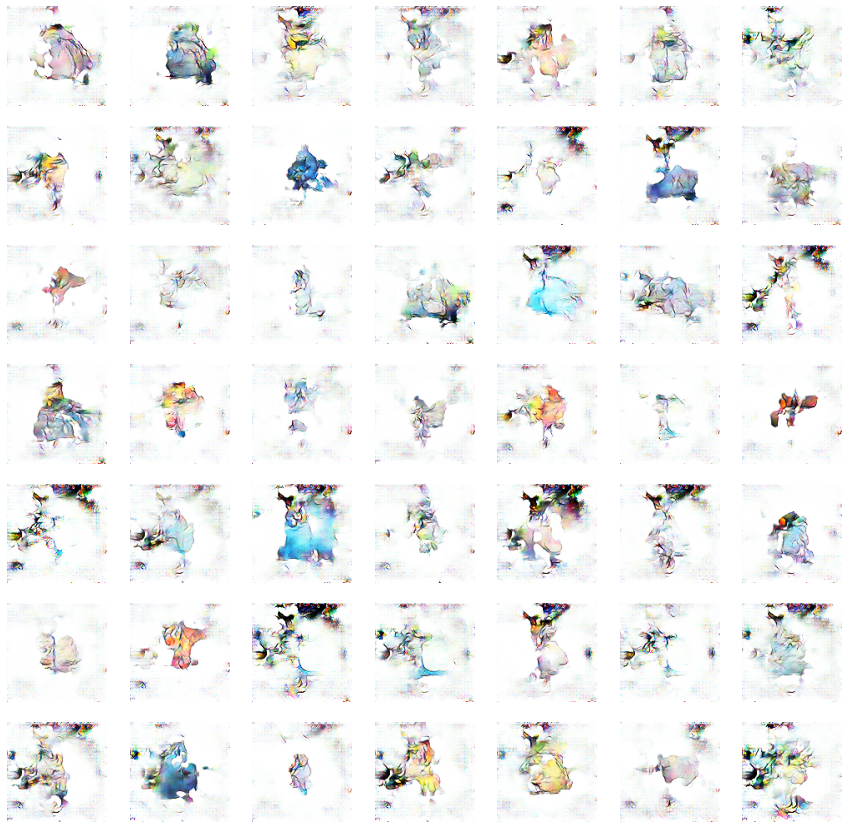

dis loss i
0.02290799468755722 0.05340731143951416 1550
dis loss i
0.05955856665968895 0.060315776616334915 1551
dis loss i
0.02166910655796528 0.021483829244971275 1552
dis loss i
0.23181432485580444 0.4268572926521301 1553
dis loss i
0.14718709886074066 0.21393190324306488 1554
dis loss i
0.049286000430583954 0.1976495087146759 1555
dis loss i
0.01664026826620102 0.0788353830575943 1556
dis loss i
0.027411481365561485 0.014546027407050133 1557
dis loss i
0.10762815922498703 0.022239163517951965 1558
dis loss i
1.59221351146698 0.4249931275844574 1559
dis loss i
0.21241730451583862 0.5028185248374939 1560
dis loss i
0.19554823637008667 0.3426494598388672 1561
dis loss i
0.2174135446548462 0.6381027698516846 1562
dis loss i
0.172493115067482 0.2325199842453003 1563
dis loss i
0.07541520148515701 0.06253768503665924 1564
dis loss i
0.04648633301258087 0.2681421637535095 1565
dis loss i
0.1127844899892807 0.09960153698921204 1566
dis loss i
0.06682489067316055 0.1884099543094635 1567
dis

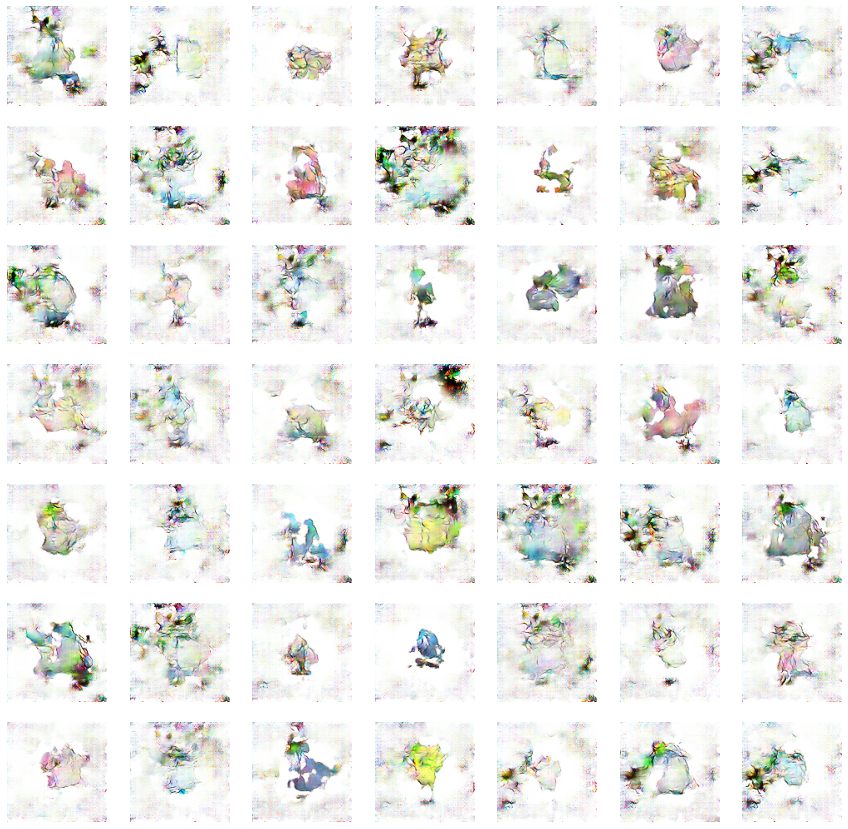

dis loss i
0.024491094052791595 0.07395924627780914 1600
dis loss i
0.024824805557727814 0.015010857954621315 1601
dis loss i
0.09532921761274338 0.08037533611059189 1602
dis loss i
0.0053386082872748375 0.12283827364444733 1603
dis loss i
0.019934268668293953 0.0013540260260924697 1604
dis loss i
0.1736837774515152 0.10103116184473038 1605
dis loss i
0.005943723488599062 0.11074545234441757 1606
dis loss i
0.005217932630330324 0.04093831777572632 1607
dis loss i
0.005134127102792263 0.17183545231819153 1608
dis loss i
0.013487642630934715 0.05314549058675766 1609
dis loss i
0.004236297216266394 0.02668476477265358 1610
dis loss i
0.008959438651800156 0.00015071856614667922 1611
dis loss i
0.01848338171839714 0.03203273192048073 1612
dis loss i
0.06503064930438995 0.0015150560066103935 1613
dis loss i
0.10268068313598633 0.12699195742607117 1614
dis loss i
0.03180331736803055 0.04736742004752159 1615
dis loss i
0.03795627877116203 0.13366280496120453 1616
dis loss i
0.11757580935955048

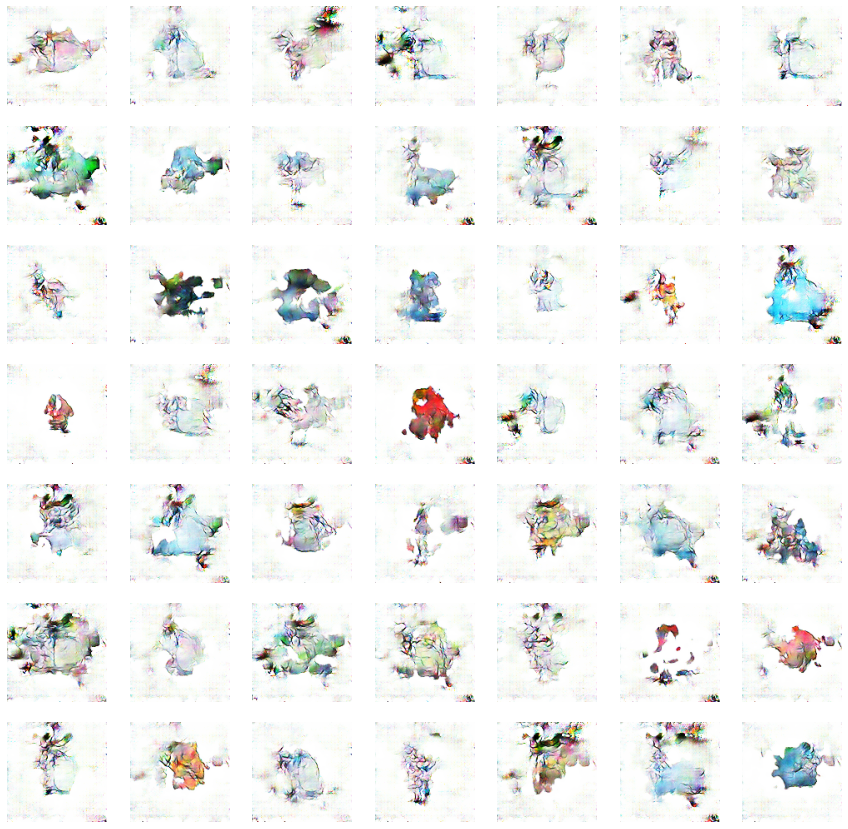

dis loss i
0.042608294636011124 0.0016849287785589695 1650
dis loss i
0.0024926471523940563 0.07032070308923721 1651
dis loss i
0.0034183778334409 0.07412618398666382 1652
dis loss i
0.005064776167273521 0.010802696458995342 1653
dis loss i
0.014205515384674072 0.00742550753057003 1654
dis loss i
0.006525116506963968 0.0014968982432037592 1655
dis loss i
0.009407006204128265 0.004027930554002523 1656
dis loss i
0.0035521225072443485 0.04896451532840729 1657
dis loss i
0.013172651641070843 0.01657501608133316 1658
dis loss i
0.00869278609752655 0.0005956812528893352 1659
dis loss i
0.007118395529687405 0.03403957188129425 1660
dis loss i
0.017219312489032745 0.027689669281244278 1661
dis loss i
0.005381986033171415 0.013024314306676388 1662
dis loss i
0.0022066915407776833 0.04757069796323776 1663
dis loss i
0.005360778421163559 0.06387633085250854 1664
dis loss i
0.01105748675763607 0.04717590659856796 1665
dis loss i
0.0020866701379418373 0.02030637115240097 1666
dis loss i
0.00906734

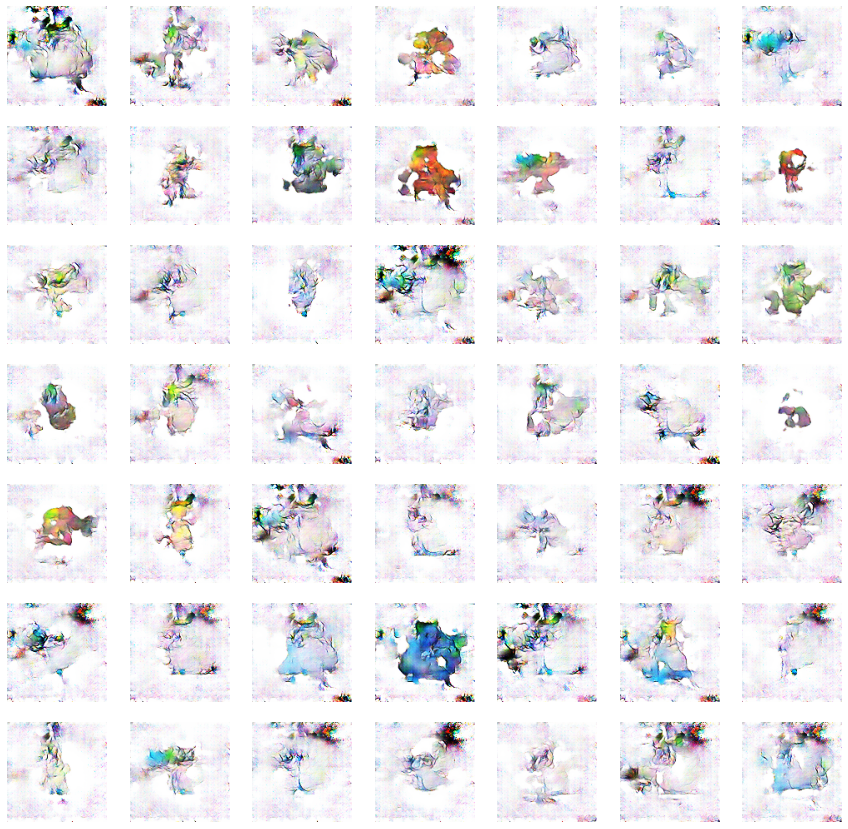

dis loss i
0.005315487273037434 0.009445929899811745 1700
dis loss i
0.0016294961096718907 0.027802376076579094 1701
dis loss i
0.08374132215976715 0.04735931009054184 1702
dis loss i
0.01712808571755886 0.018853986635804176 1703
dis loss i
0.00827933568507433 0.004179548472166061 1704
dis loss i
0.12785044312477112 0.12177430093288422 1705
dis loss i
0.023366978392004967 0.05483490228652954 1706
dis loss i
0.020552845671772957 0.035185057669878006 1707
dis loss i
0.008176879025995731 0.0018378442618995905 1708
dis loss i
0.006297247484326363 0.0008930154144763947 1709
dis loss i
0.01728535071015358 0.0013239759718999267 1710
dis loss i
0.07827083021402359 0.12857860326766968 1711
dis loss i
0.027911625802516937 0.007916996255517006 1712
dis loss i
0.001184331951662898 0.001068294863216579 1713
dis loss i
0.017375415191054344 0.010551569052040577 1714
dis loss i
0.00881880521774292 0.003805457381531596 1715
dis loss i
0.06809300929307938 0.22464166581630707 1716
dis loss i
0.1430096626

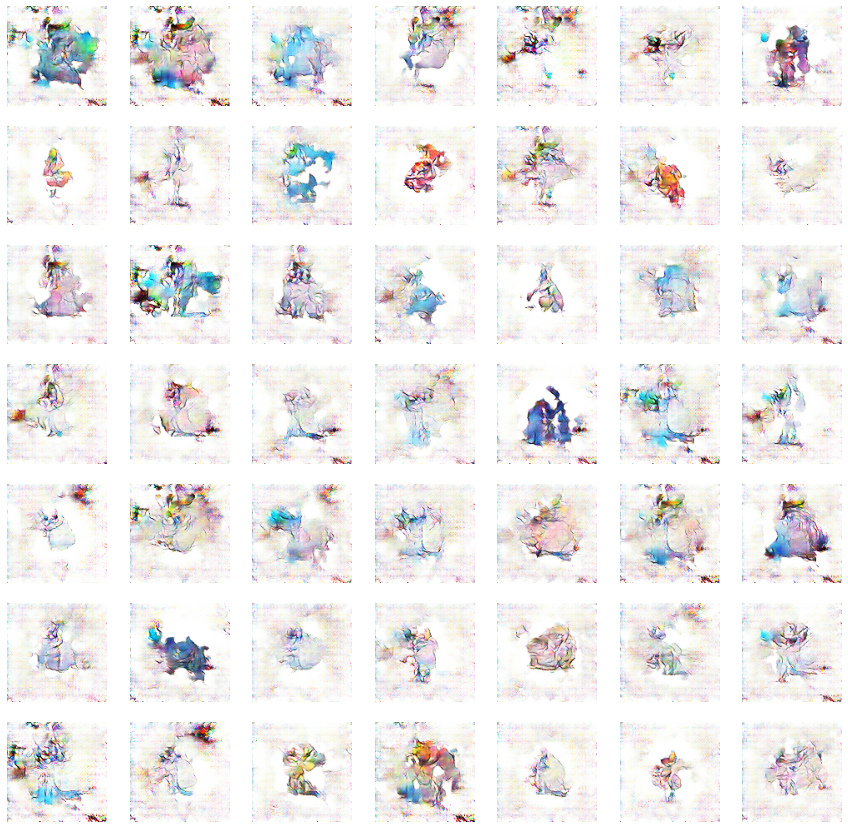

dis loss i
0.003725234419107437 0.23932816088199615 1750
dis loss i
0.02264406904578209 0.05034917593002319 1751
dis loss i
0.08451944589614868 0.005571774207055569 1752
dis loss i
0.005984101910144091 0.016098231077194214 1753
dis loss i
0.0008903166744858027 0.047194704413414 1754
dis loss i
0.011743557639420033 0.04791785404086113 1755
dis loss i
0.02289600670337677 0.027714554220438004 1756
dis loss i
0.02552982047200203 0.09024564176797867 1757
dis loss i
0.0072901989333331585 0.006799710914492607 1758
dis loss i
0.06863775104284286 0.0584990531206131 1759
dis loss i
0.3524182438850403 0.20530889928340912 1760
dis loss i
0.030314914882183075 0.09668347984552383 1761
dis loss i
0.011169608682394028 0.0020435363985598087 1762
dis loss i
0.01554700918495655 0.02363021858036518 1763
dis loss i
0.002504309406504035 0.0009282673709094524 1764
dis loss i
0.007283611223101616 0.07133036106824875 1765
dis loss i
0.0021298653446137905 0.0031110220588743687 1766
dis loss i
0.0320919603109359

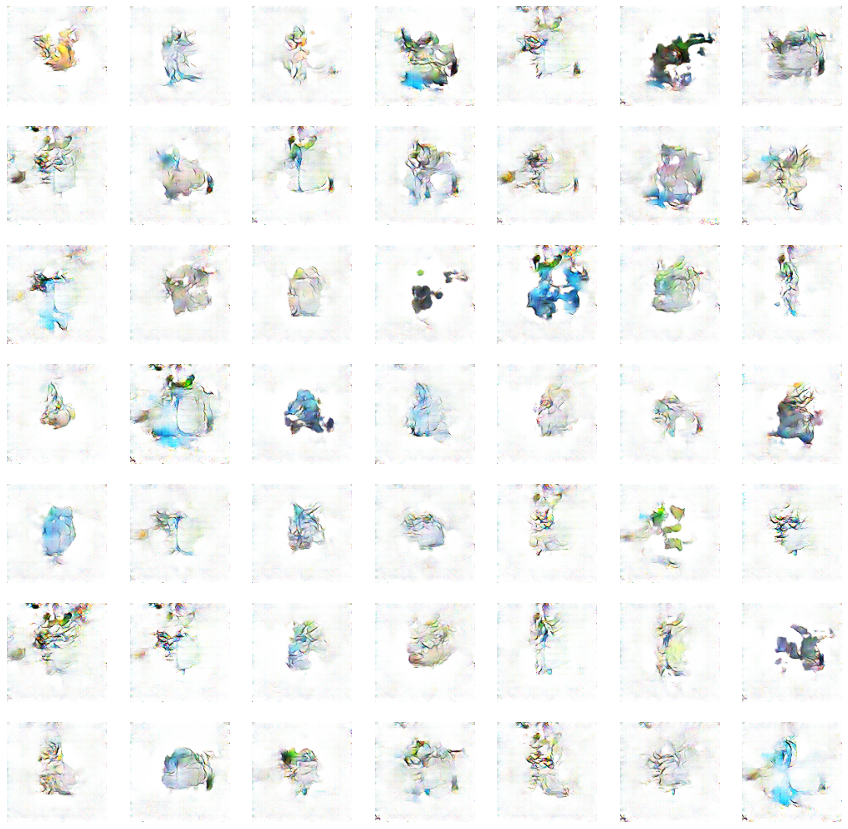

dis loss i
0.008210997097194195 0.021837802603840828 1800
dis loss i
0.023951468989253044 0.04382358491420746 1801
dis loss i
0.013955175876617432 0.03098144382238388 1802
dis loss i
0.016158394515514374 0.05801134929060936 1803
dis loss i
0.004193419590592384 0.008968144655227661 1804
dis loss i
0.007462867069989443 0.007304470520466566 1805
dis loss i
0.043718915432691574 0.08189906924962997 1806
dis loss i
0.03747548162937164 0.013147827237844467 1807
dis loss i
0.0006491264211945236 0.001395635074004531 1808
dis loss i
0.03112666681408882 0.09962154179811478 1809
dis loss i
0.027842476963996887 0.010982630774378777 1810
dis loss i
0.021650386974215508 0.019546620547771454 1811
dis loss i
0.014899180270731449 0.15956269204616547 1812
dis loss i
0.013605820015072823 0.027709266170859337 1813
dis loss i
0.0040911161340773106 0.11278530955314636 1814
dis loss i
0.03086722642183304 0.019339224323630333 1815
dis loss i
0.004401993006467819 0.0005116327083669603 1816
dis loss i
0.03284047

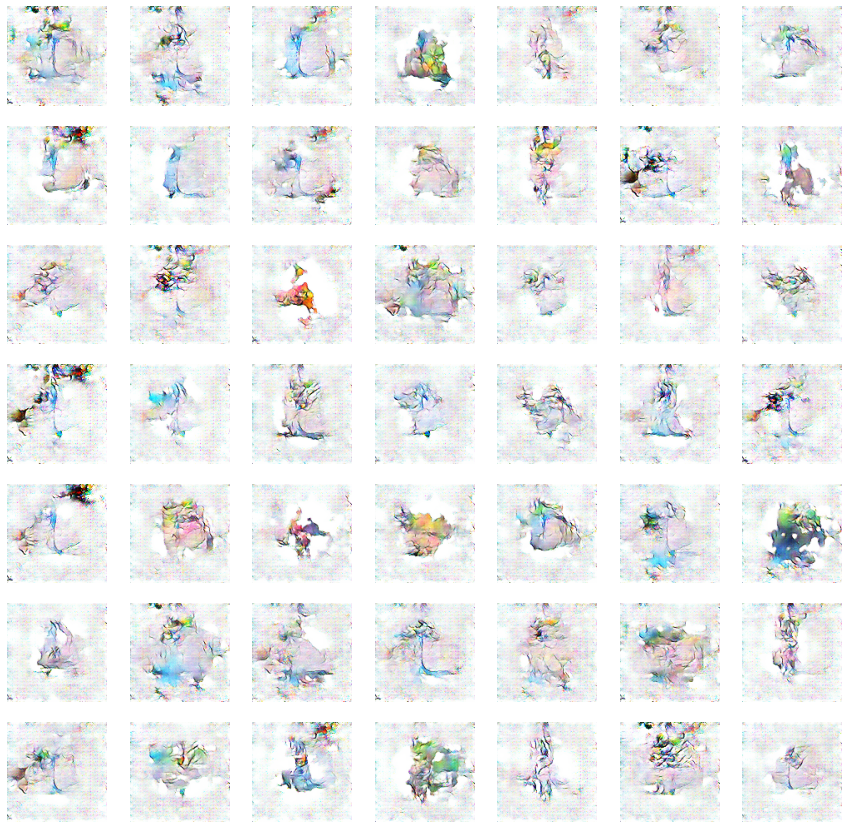

dis loss i
0.0019273963989689946 0.04117043316364288 1850
dis loss i
0.011285822838544846 0.02650722861289978 1851
dis loss i
0.46271398663520813 0.42084968090057373 1852
dis loss i
0.2040121853351593 0.10433151572942734 1853
dis loss i
0.2419811636209488 0.42753341794013977 1854
dis loss i
0.01083369366824627 0.0850667655467987 1855
dis loss i
0.05539146438241005 0.019967326894402504 1856
dis loss i
0.007629789877682924 0.04016737639904022 1857
dis loss i
0.00586266303434968 0.0827295184135437 1858
dis loss i
0.016750527545809746 0.06686271727085114 1859
dis loss i
0.011802825145423412 0.005448060110211372 1860
dis loss i
0.012022322975099087 0.07297906279563904 1861
dis loss i
0.02319365181028843 0.0007387319346889853 1862
dis loss i
0.0041197906248271465 0.004173664376139641 1863
dis loss i
0.005787340924143791 0.007424291223287582 1864
dis loss i
0.03218124806880951 0.03677945211529732 1865
dis loss i
0.03791843354701996 0.03951764851808548 1866
dis loss i
0.04836148023605347 0.062

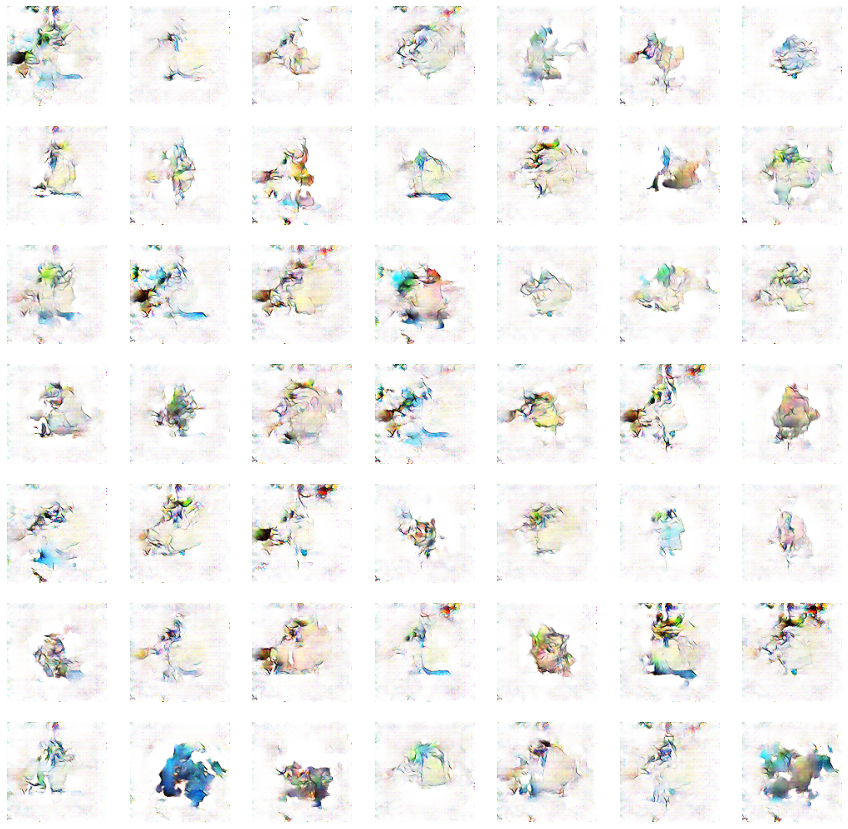

dis loss i
0.03616337850689888 0.017358053475618362 1900
dis loss i
0.0023493366315960884 0.028606407344341278 1901
dis loss i
0.034161053597927094 0.25652411580085754 1902
dis loss i
0.011368343606591225 0.07444901019334793 1903
dis loss i
0.0955667793750763 0.017232732847332954 1904
dis loss i
0.009215830825269222 0.01209256425499916 1905
dis loss i
0.014488041400909424 0.01313415914773941 1906
dis loss i
0.034675922244787216 0.004169648513197899 1907
dis loss i
0.0008061897242441773 0.24424315989017487 1908
dis loss i
0.05620788410305977 0.005761939100921154 1909
dis loss i
0.0012967456132173538 0.04755599796772003 1910
dis loss i
0.0013984231045469642 0.0034752648789435625 1911
dis loss i
0.08899103105068207 0.07756683975458145 1912
dis loss i
0.02870209701359272 0.2680966258049011 1913
dis loss i
0.011260171420872211 0.17193882167339325 1914
dis loss i
0.011506784707307816 0.00997517816722393 1915
dis loss i
0.10378730297088623 0.02860793098807335 1916
dis loss i
0.014041665010154

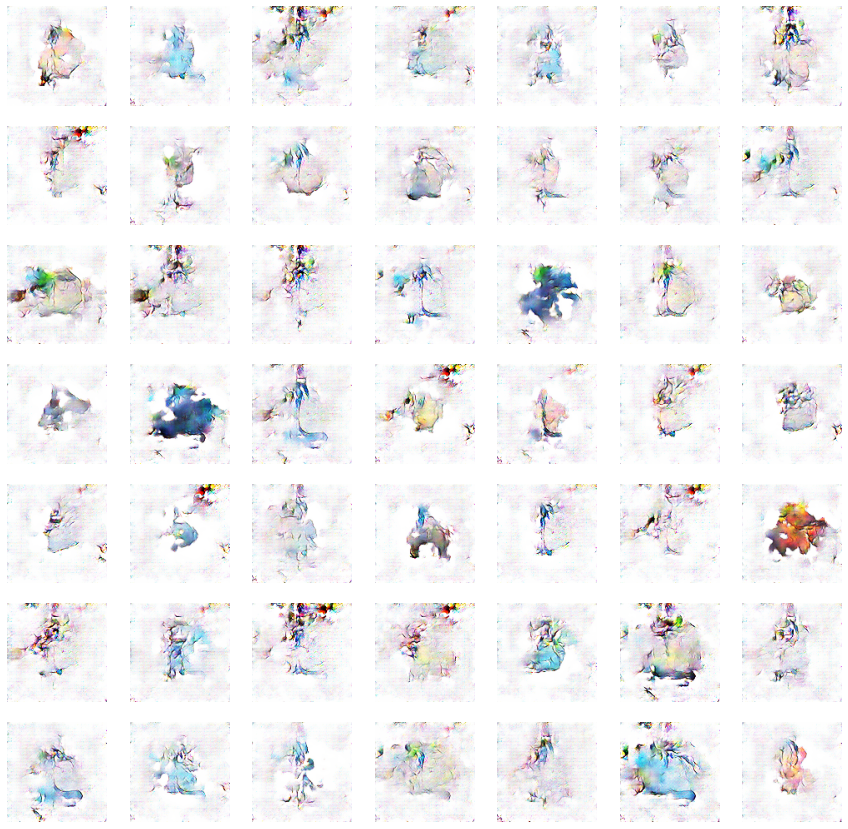

dis loss i
0.015993962064385414 0.0036263836082071066 1950
dis loss i
0.0012699393555521965 0.005000627599656582 1951
dis loss i
0.0035980376414954662 0.056460198014974594 1952
dis loss i
0.017663657665252686 0.04492471367120743 1953
dis loss i
0.0016804258339107037 0.1031300276517868 1954
dis loss i
0.0008435004856437445 0.007570302579551935 1955
dis loss i
0.06374407559633255 0.0018811915069818497 1956
dis loss i
0.11660993099212646 0.003510725684463978 1957
dis loss i
0.0011382759548723698 0.0031425761990249157 1958
dis loss i
0.015280770137906075 0.0032767371740192175 1959
dis loss i
0.003952442668378353 0.008916579186916351 1960
dis loss i
0.0012977068545296788 0.00377997406758368 1961
dis loss i
0.0008663064218126237 0.007855654694139957 1962
dis loss i
0.002276708371937275 0.10051959753036499 1963
dis loss i
0.02014259062707424 0.002044829772785306 1964
dis loss i
0.0022654247004538774 0.0750819742679596 1965
dis loss i
0.017559703439474106 0.00967851560562849 1966
dis loss i
0.

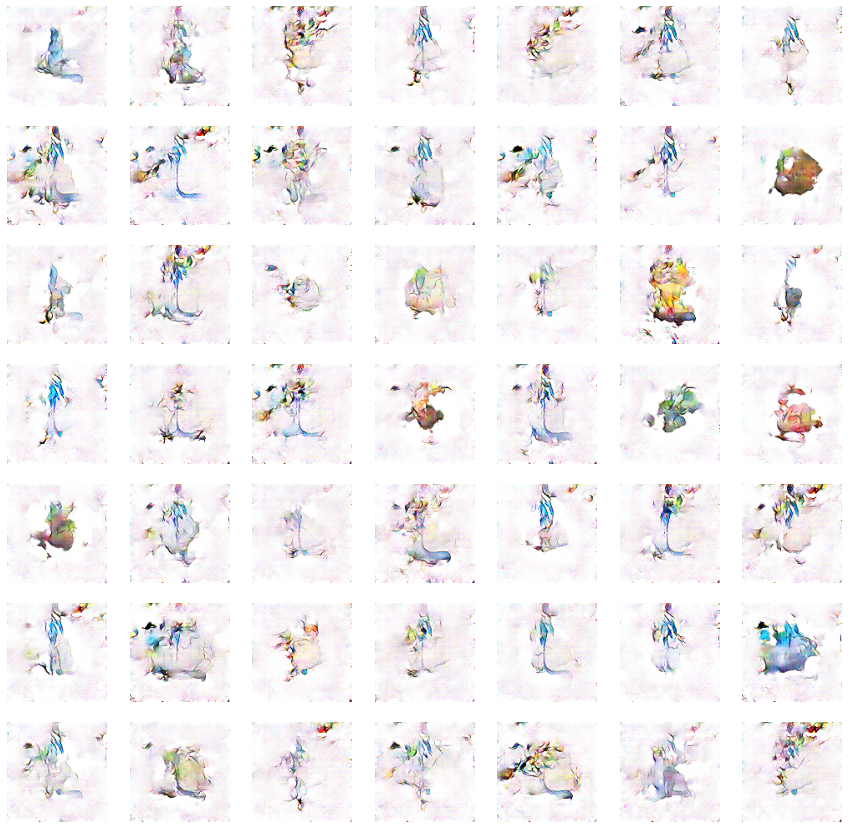

In [ ]:
train(g_model, d_model, gan_model, dataset)

In [ ]:
g_model.save("pokemons_2000.h5")

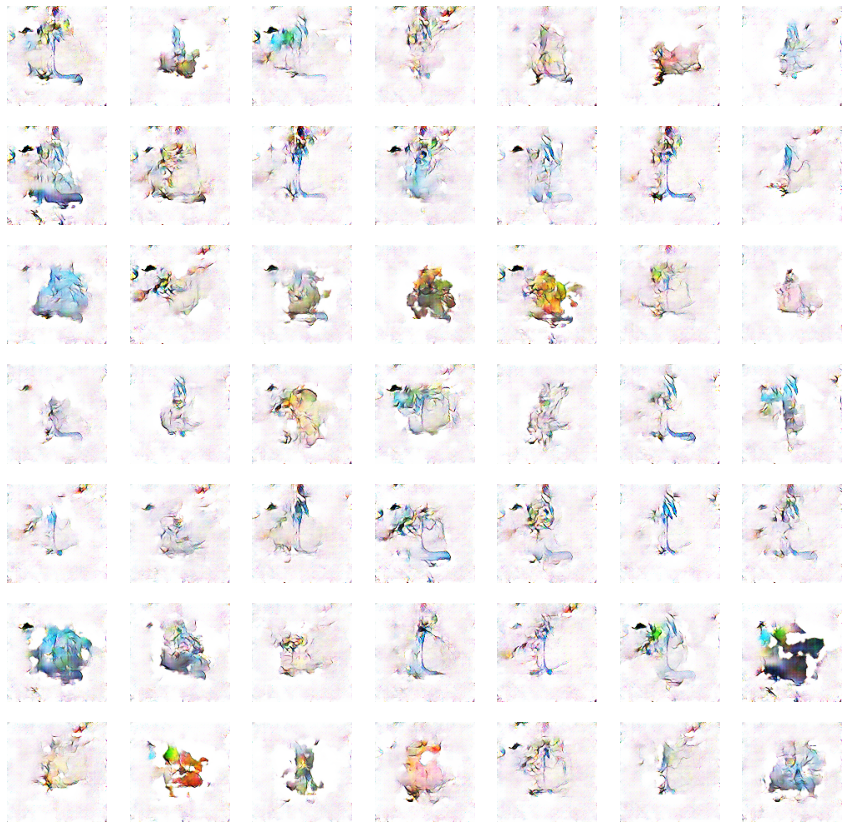

In [ ]:
# X from the latent space
X_input = generate_latent_space(n_size = 49)
# generate new Pokemon
preds = g_model.predict(X_input)
plot_samples(preds)